# Multi Modal Demo

Required to run this code:
```bash
pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
pip install transformers
pip install accelerate
pip install bitsandbytes
pip install datasets
pip install tqdm
```

/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


DatasetDict({
    train: Dataset({
        features: ['image', 'text'],
        num_rows: 833
    })
})

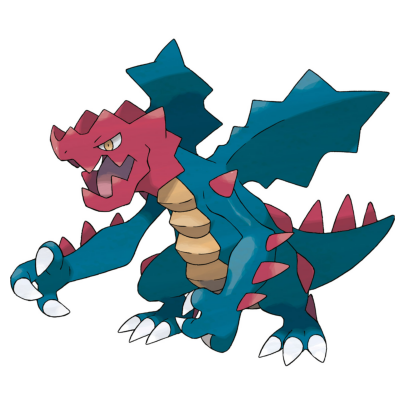

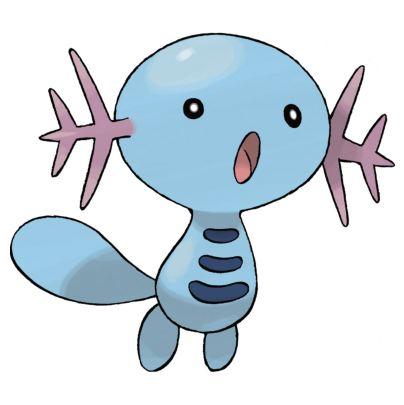

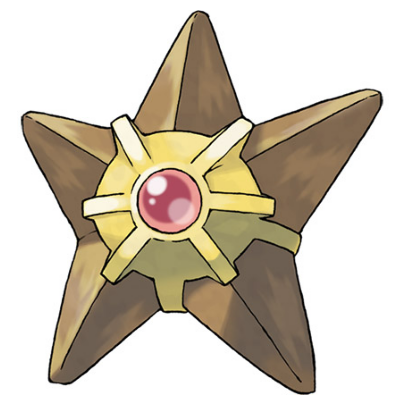

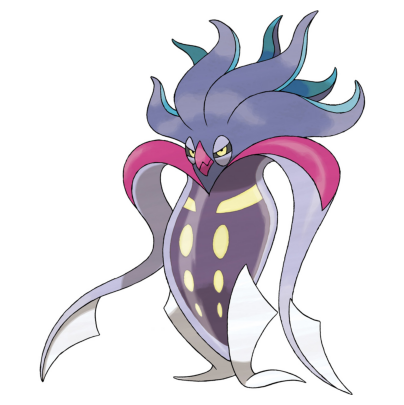

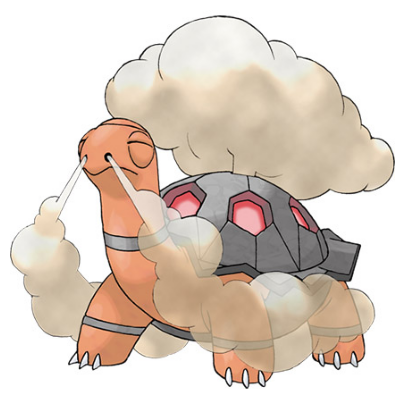

In [1]:
import torch
import random
import pandas as pd
import matplotlib.pyplot as graph
from transformers import BitsAndBytesConfig, pipeline
from datasets import load_dataset
from tqdm.auto import tqdm
from IPython.display import display, Markdown
random.seed(42)


def plot_image(image):
    graph.figure(figsize=(5, 5))
    graph.imshow(image)
    graph.axis('off')
    graph.show()


image_ds = load_dataset('lambdalabs/pokemon-blip-captions')
display(image_ds)

for i in (random.randrange(0, 800) for _ in range(5)):
    plot_image(image_ds['train'][i]['image'])

# Model Setup

In [2]:
def base_prompt(text):
    return f'USER: <image>\n{text}\nASSISTANT:'


quantization_config = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_compute_dtype=torch.float16
)


model_pipeline = pipeline(
    'image-to-text',
    #model='llava-hf/llava-1.5-7b-hf',  # Small size model
    model='llava-hf/vip-llava-13b-hf',  # Mid size model
    model_kwargs={
        'quantization_config': quantization_config,
    }
)
print('== READY ==')

Loading checkpoint shards: 100%|██████████| 6/6 [00:08<00:00,  1.36s/it]
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


== READY ==


# Generate Outputs

  0%|          | 0/200 [00:00<?, ?it/s]/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/transformers/generation/configuration_utils.py:392: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.2` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


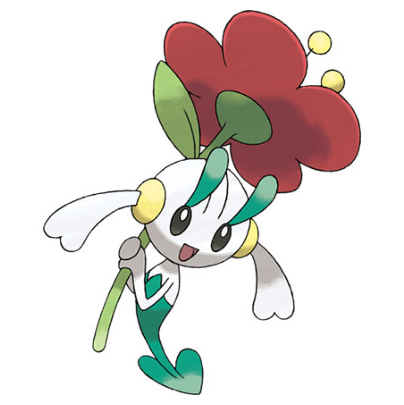

1. The creature is primarily white with green accents.
2. The creature has a friendly expression with a smile and wide eyes, which suggests it is approachable and possibly curious or playful.

---

  0%|          | 1/200 [00:55<3:04:18, 55.57s/it]

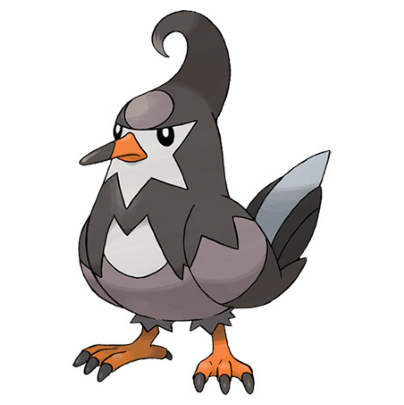

1. The creature is primarily black with some white and grey accents.
2. The creature looks unfriendly due to its sharp beak and piercing eyes, which can be interpreted as a threat or aggression.

---

  1%|          | 2/200 [01:54<3:10:35, 57.76s/it]

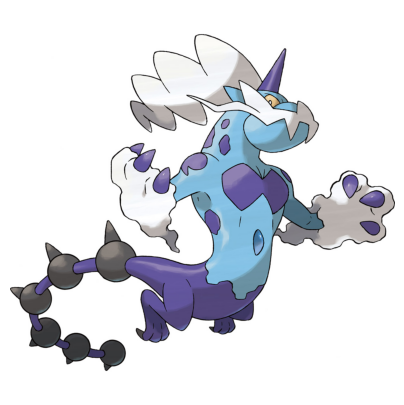

1. The creature is blue and white.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming or happy.

---

  2%|▏         | 3/200 [02:53<3:11:27, 58.31s/it]

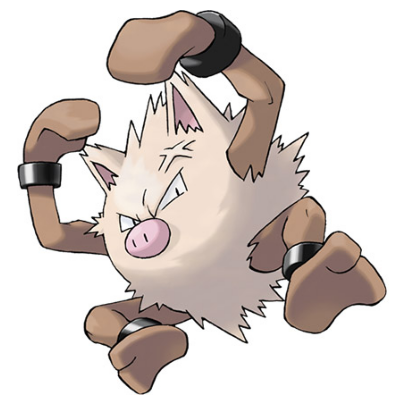

1. The creature is white.
2. The creature looks very unfriendly. It has a very angry expression with its eyes wide open and its mouth agape, suggesting it is ready to attack or defend itself.

---

  2%|▏         | 4/200 [03:56<3:16:16, 60.08s/it]

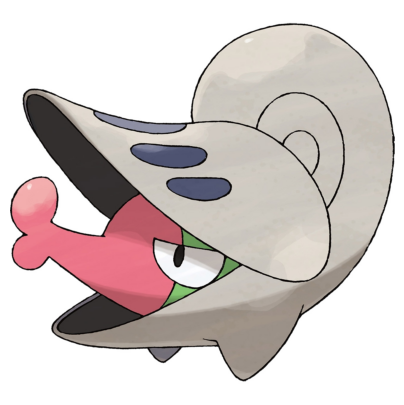

1. The creature is primarily pink with blue spots.
2. The creature looks unfriendly due to its open mouth and the menacing appearance of its teeth.

---

  2%|▎         | 5/200 [04:56<3:15:11, 60.06s/it]

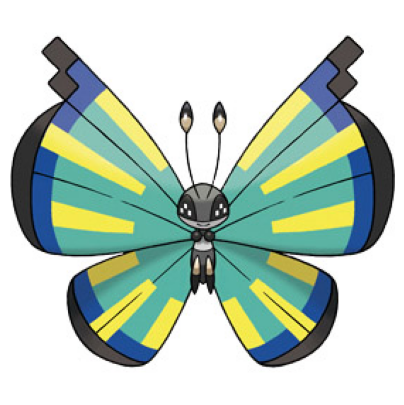

1. The creature is primarily blue with yellow and black accents.
2. The creature has a friendly expression, with a smile and wide eyes that suggest it is happy to see someone.

---

  3%|▎         | 6/200 [05:58<3:16:23, 60.74s/it]

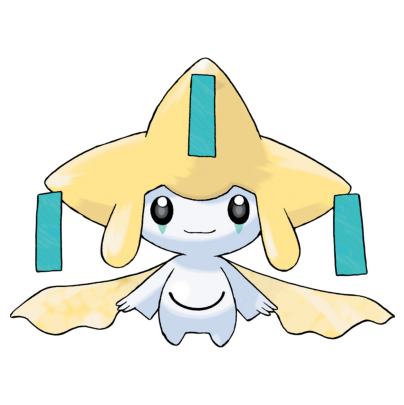

1. The creature is white with yellow accents.
2. The creature looks friendly with its big, expressive eyes and the way it's smiling.

---

  4%|▎         | 7/200 [06:58<3:13:55, 60.29s/it]

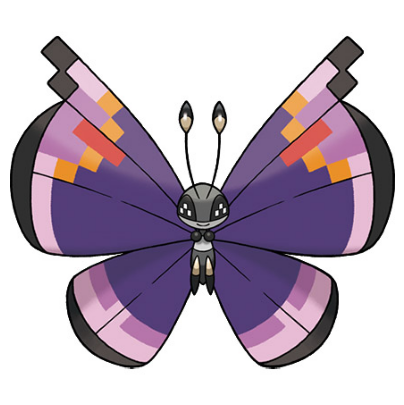

1. The creature is purple and black.
2. The creature looks friendly, as it has a big smile and is posing for the camera.

---

  4%|▍         | 8/200 [08:01<3:15:47, 61.19s/it]

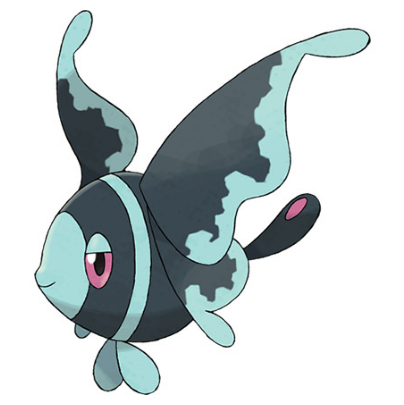

1. The creature is primarily blue with some black and white accents.
2. The creature has a somewhat unfriendly appearance due to its large, sharp teeth and the intense, red eyes.

---

  4%|▍         | 9/200 [09:00<3:12:58, 60.62s/it]

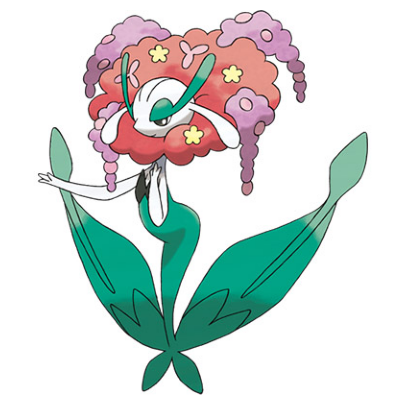

1. The creature is primarily green with pink and purple accents.
2. The creature has a friendly appearance, with a gentle smile and a welcoming pose.

---

  5%|▌         | 10/200 [09:58<3:09:36, 59.88s/it]/home/sar/miniconda3/envs/ai/lib/python3.12/site-packages/transformers/pipelines/base.py:1123: UserWarning: You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
  warnings.warn(


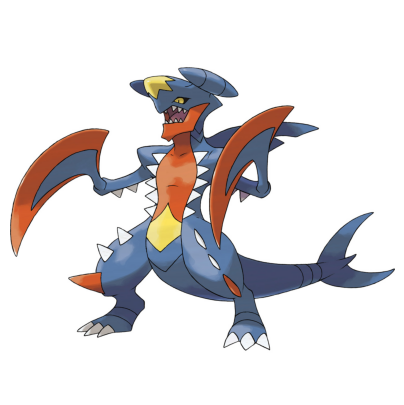

1. The creature is blue.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture with its arms outstretched and mouth open.

---

  6%|▌         | 11/200 [10:57<3:07:54, 59.66s/it]

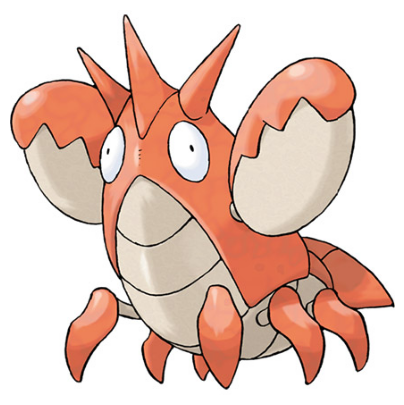

1. The creature is red.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

  6%|▌         | 12/200 [11:53<3:03:18, 58.50s/it]

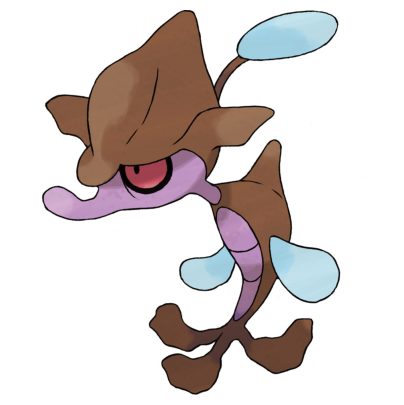

1. The creature is primarily brown with some purple accents.
2. The creature has a somewhat unfriendly appearance due to its large, sharp teeth and the intense red eyes, which can be perceived as intimidating or aggressive.

---

  6%|▋         | 13/200 [12:54<3:04:36, 59.23s/it]

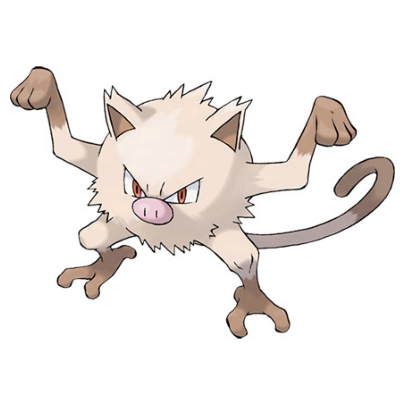

1. The creature is white.
2. The creature looks very unfriendly. Its facial expression is intense and its body language is aggressive, with its arms outstretched and its mouth open in a snarling manner.

---

  7%|▋         | 14/200 [13:54<3:03:56, 59.33s/it]

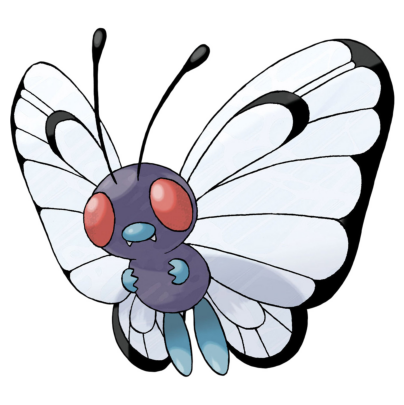

1. The creature is purple with red eyes.
2. The creature looks unfriendly due to its sharp teeth and the intense expression on its face.

---

  8%|▊         | 15/200 [14:54<3:03:30, 59.52s/it]

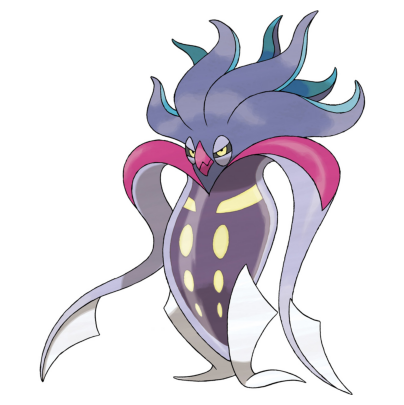

1. The creature is primarily blue with pink and yellow accents.
2. The creature has a somewhat unfriendly appearance due to its sharp teeth and the intense look in its eyes.

---

  8%|▊         | 16/200 [15:52<3:01:36, 59.22s/it]

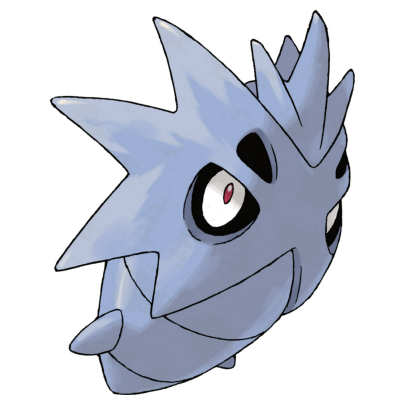

1. The creature is blue.
2. The creature looks unfriendly due to its large, dark eyes and the way its mouth is open in a way that suggests it might be screaming or making a sound.

---

  8%|▊         | 17/200 [16:52<3:00:57, 59.33s/it]

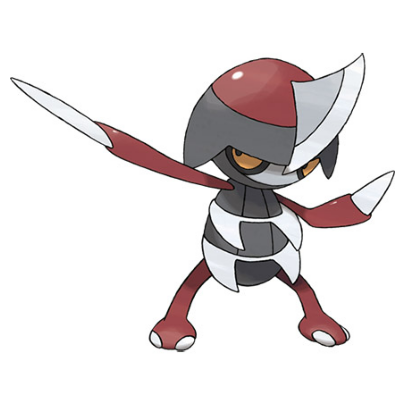

1. The creature is primarily red and black.
2. The creature looks unfriendly due to its sharp teeth and intense stare.

---

  9%|▉         | 18/200 [17:55<3:03:01, 60.34s/it]

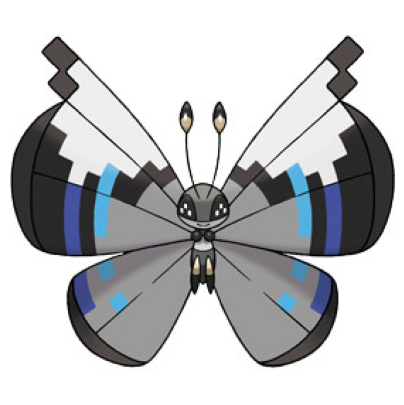

1. The creature is primarily black and white with some blue accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly.

---

 10%|▉         | 19/200 [18:54<3:01:20, 60.11s/it]

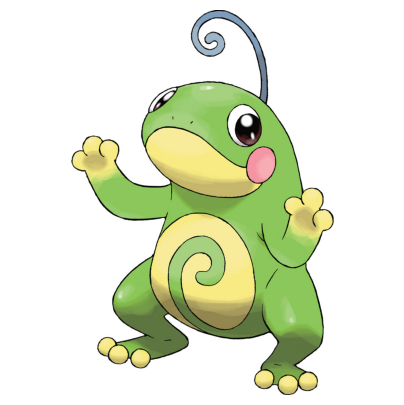

1. The creature is green with yellow and pink accents.
2. The creature looks friendly, with its arms outstretched and a cheerful expression.

---

 10%|█         | 20/200 [20:02<3:07:29, 62.50s/it]

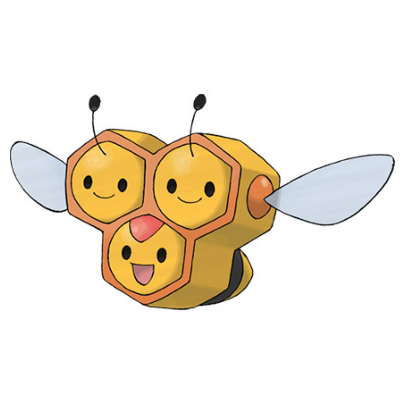

1. The creature is yellow.
2. The creature looks very friendly. It has a big smile and its body language suggests it is happy and approachable.

---

 10%|█         | 21/200 [21:07<3:08:49, 63.29s/it]

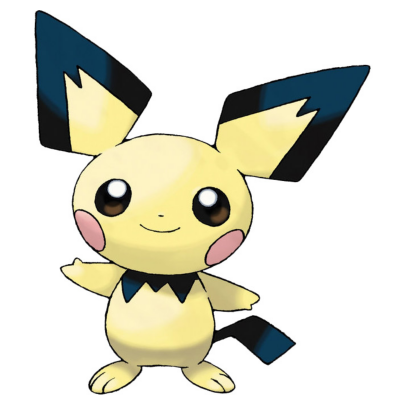

1. The creature is yellow with blue accents.
2. The creature looks friendly. Its facial expression is one of contentment and it is posing in a welcoming manner with its arms outstretched.

---

 11%|█         | 22/200 [22:12<3:08:53, 63.67s/it]

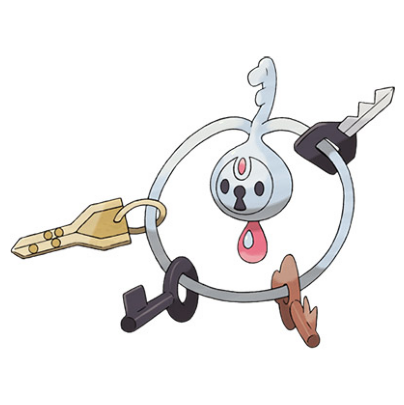

1. The creature is white.
2. The creature looks unfriendly due to its facial expression and the way it is holding the key.

---

 12%|█▏        | 23/200 [23:10<3:02:46, 61.96s/it]

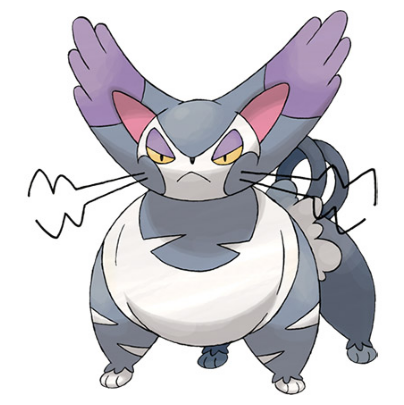

1. The creature is blue and white.
2. The creature looks unfriendly due to its wide-eyed expression and the way its mouth is open, suggesting it might be growling or hissing.

---

 12%|█▏        | 24/200 [24:10<2:59:50, 61.31s/it]

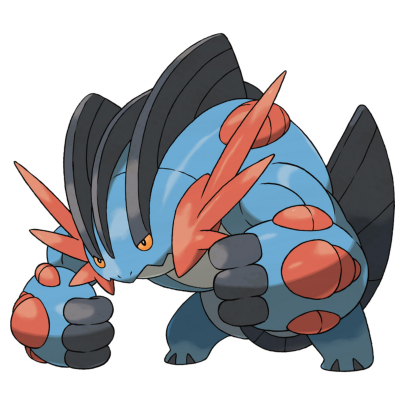

1. The creature is blue with red accents.
2. The creature looks unfriendly due to its large size, sharp claws, and the menacing expression on its face.

---

 12%|█▎        | 25/200 [25:08<2:56:16, 60.44s/it]

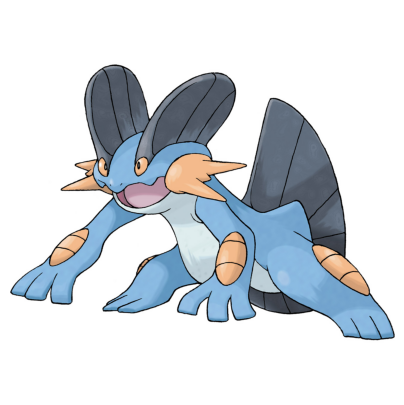

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 13%|█▎        | 26/200 [26:04<2:51:41, 59.20s/it]

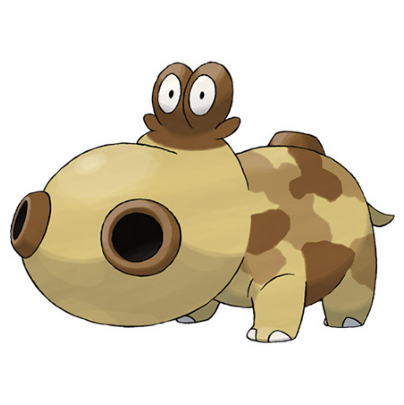

1. The creature is brown and white.
2. The creature looks friendly, as it has a smiling face and a relaxed posture.

---

 14%|█▎        | 27/200 [27:01<2:48:42, 58.51s/it]

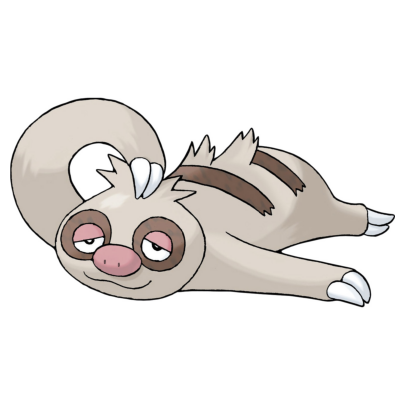

1. The creature is grey and white.
2. The creature looks friendly, as it has a smiling expression and is depicted in a relaxed, reclining position.

---

 14%|█▍        | 28/200 [28:06<2:52:51, 60.30s/it]

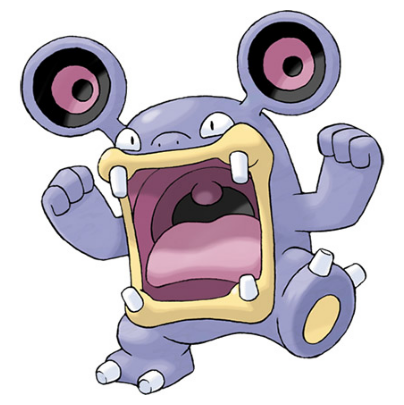

1. The creature is purple.
2. The creature looks very friendly. It has a big smile and its eyes are wide open, which often indicates happiness or excitement.

---

 14%|█▍        | 29/200 [29:11<2:56:16, 61.85s/it]

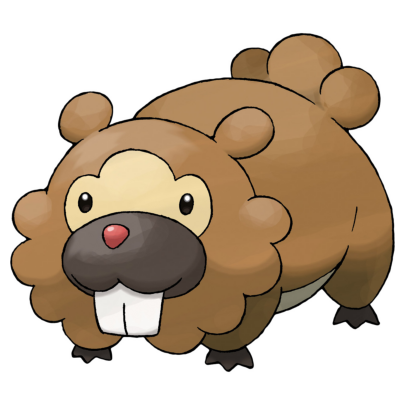

1. The creature is brown.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 15%|█▌        | 30/200 [30:14<2:56:13, 62.20s/it]

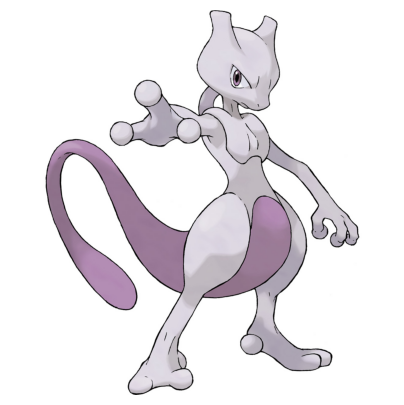

1. The creature is primarily white with some purple accents.
2. The creature looks unfriendly due to its intense stare and the way it is positioned with its arms outstretched, possibly in a defensive or aggressive posture.

---

 16%|█▌        | 31/200 [31:13<2:52:05, 61.10s/it]

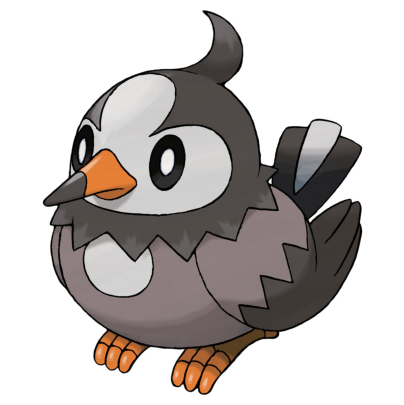

1. The creature is primarily black and white with some grey and orange accents.
2. The creature looks friendly, with a wide-eyed expression and a slightly open beak, which could indicate curiosity or friendliness.

---

 16%|█▌        | 32/200 [32:09<2:47:26, 59.80s/it]

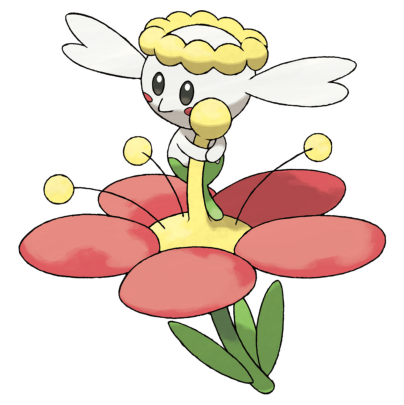

1. The creature is primarily white with some yellow and green accents.
2. The creature has a friendly expression with a slight smile and a relaxed posture, suggesting it is not hostile or aggressive.

---

 16%|█▋        | 33/200 [32:49<2:29:35, 53.75s/it]

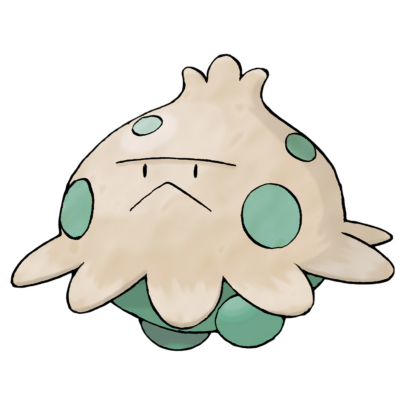

1. The creature is primarily white with green spots.
2. The creature looks unfriendly due to its frowning facial expression and the overall somber demeanor.

---

 17%|█▋        | 34/200 [33:18<2:08:04, 46.29s/it]

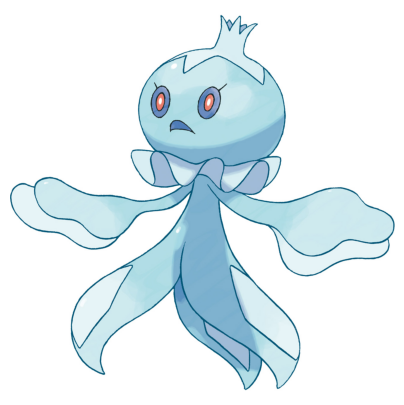

1. The creature is blue.
2. The creature looks unfriendly due to its facial expression and the way it is positioned with its arms outstretched.

---

 18%|█▊        | 35/200 [33:44<1:50:41, 40.25s/it]

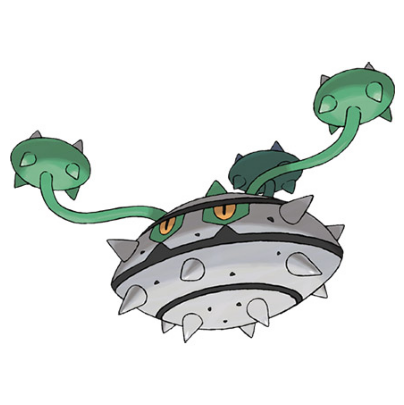

1. The creature is green and white.
2. The creature looks unfriendly due to its sharp teeth and the menacing expression on its face.

---

 18%|█▊        | 36/200 [34:08<1:36:25, 35.28s/it]

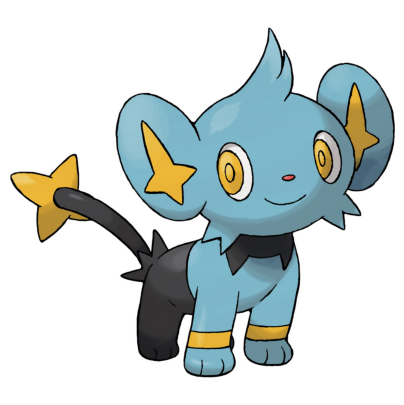

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its eyes are wide open, which can indicate happiness or excitement.

---

 18%|█▊        | 37/200 [34:31<1:26:20, 31.78s/it]

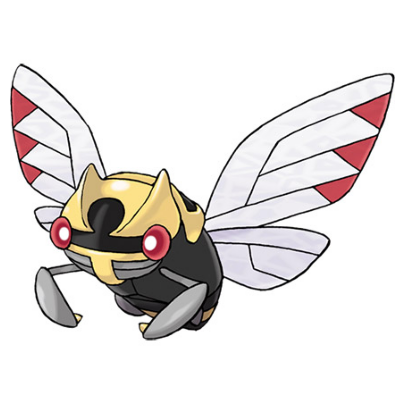

1. The creature is primarily black with yellow accents.
2. The creature looks friendly due to its large, expressive eyes and the overall cute design.

---

 19%|█▉        | 38/200 [34:55<1:19:07, 29.31s/it]

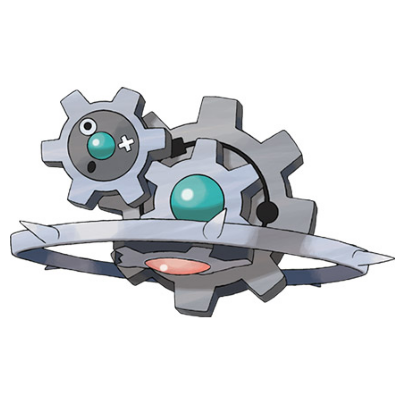

1. The creature is primarily green and white.
2. The creature looks friendly, as it has a smiling expression and is depicted as a cartoon character, which often symbolizes friendliness and approachability.

---

 20%|█▉        | 39/200 [35:18<1:13:51, 27.52s/it]

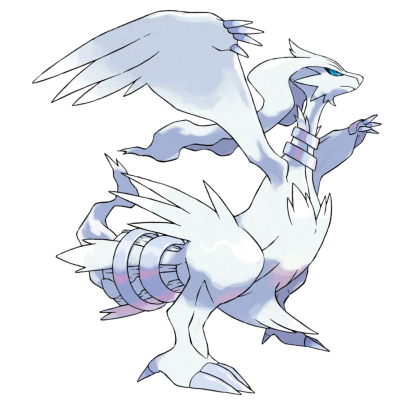

1. The creature is white.
2. The creature looks friendly. It has a gentle expression and is depicted with a posture that suggests it is welcoming or curious.

---

 20%|██        | 40/200 [35:39<1:07:49, 25.43s/it]

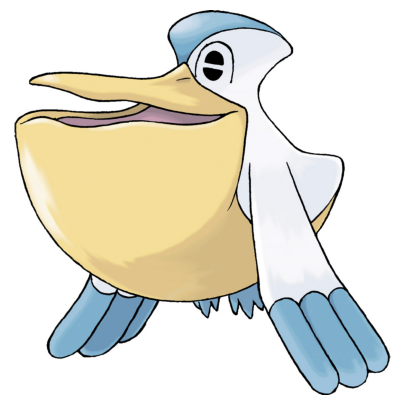

1. The creature is primarily white with blue accents.
2. The creature looks friendly, with a wide smile and a relaxed posture.

---

 20%|██        | 41/200 [35:53<58:19, 22.01s/it]  

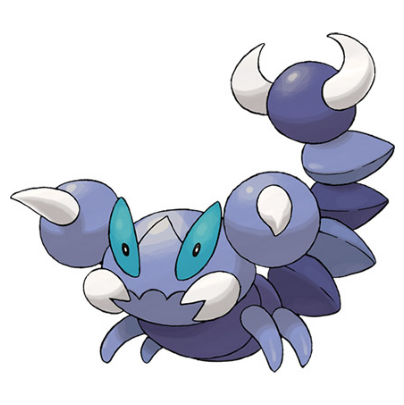

1. The creature is blue.
2. The creature looks friendly. It has a big smile and big eyes, which often indicate a friendly or approachable demeanor in cartoons or illustrations.

---

 21%|██        | 42/200 [36:05<50:15, 19.08s/it]

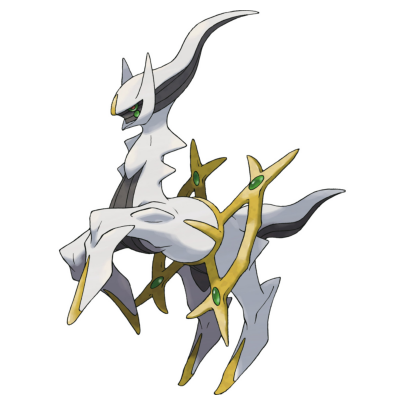

1. The creature is primarily white with some gold and green accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly. Its posture is upright and it seems to be in a state of readiness or alertness.

---

 22%|██▏       | 43/200 [36:14<42:13, 16.14s/it]

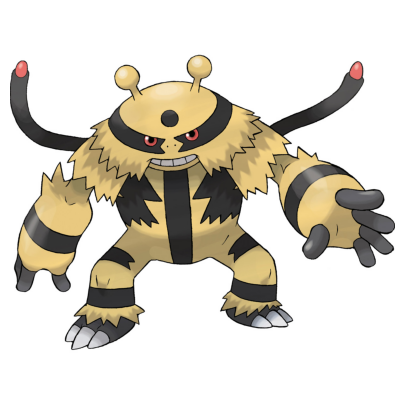

1. The creature is yellow and black.
2. The creature looks very unfriendly. Its facial expression is fierce and it has sharp teeth, which are often associated with aggression. Additionally, its posture is aggressive, with its arms outstretched and its claws extended, which can be interpreted as a threat.

---

 22%|██▏       | 44/200 [36:24<37:09, 14.29s/it]

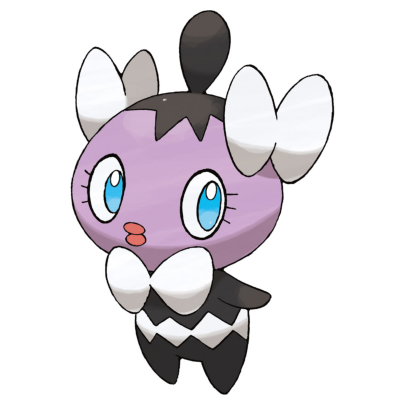

1. The creature is purple.
2. The creature looks friendly. It has a cute appearance with big eyes and a smiling expression.

---

 22%|██▎       | 45/200 [36:30<29:49, 11.55s/it]

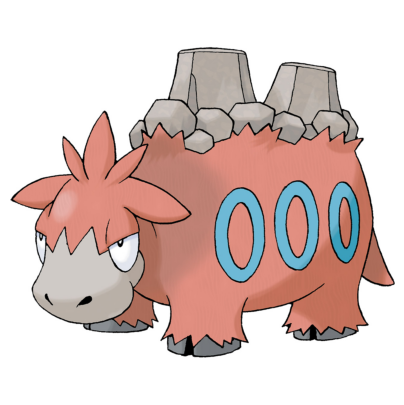

1. The creature is pink.
2. The creature looks unfriendly due to its large, sharp horns and the aggressive stance it is portrayed with.

---

 23%|██▎       | 46/200 [36:35<25:13,  9.83s/it]

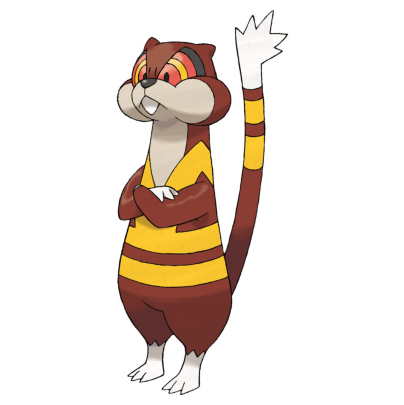

1. The creature is brown and yellow.
2. The creature looks friendly. It has a big smile and its ears are perked up, which are signs of happiness and friendliness.

---

 24%|██▎       | 47/200 [36:42<22:13,  8.72s/it]

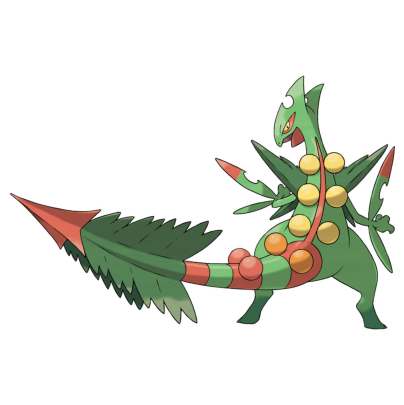

1. The creature is green with red and orange accents.
2. The creature looks friendly, with a big smile and a cheerful expression.

---

 24%|██▍       | 48/200 [36:47<19:16,  7.61s/it]

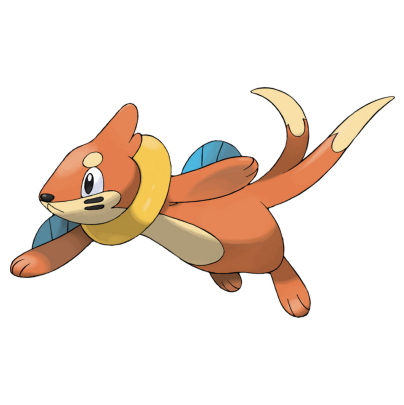

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its ears are perked up, which are signs of a happy and approachable animal.

---

 24%|██▍       | 49/200 [36:53<18:02,  7.17s/it]

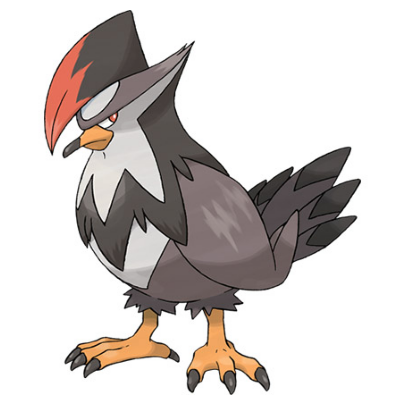

1. The creature is primarily black and white with some red accents.
2. The creature looks unfriendly due to its sharp beak and intense red eyes, which can be perceived as aggressive or intimidating.

---

 25%|██▌       | 50/200 [37:01<18:32,  7.42s/it]

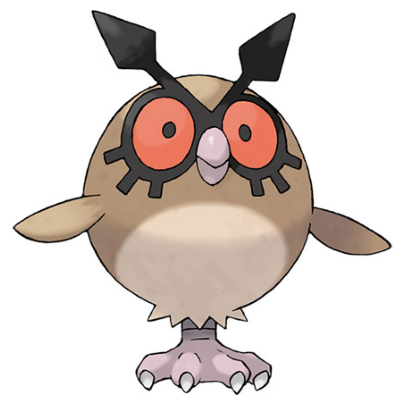

1. The creature is brown.
2. The creature looks unfriendly due to its large, piercing eyes and sharp beak, which could be perceived as intimidating or aggressive.

---

 26%|██▌       | 51/200 [37:07<17:57,  7.23s/it]

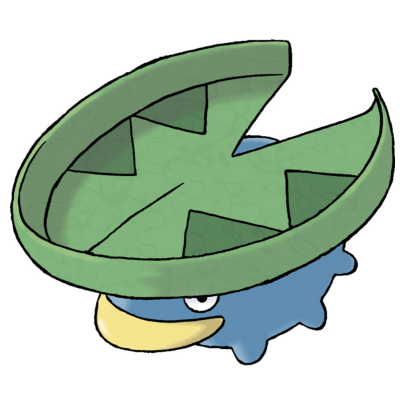

1. The creature is blue.
2. The creature looks friendly. It has a big smile and a cheerful expression, which often indicates a friendly demeanor.

---

 26%|██▌       | 52/200 [37:13<16:44,  6.79s/it]

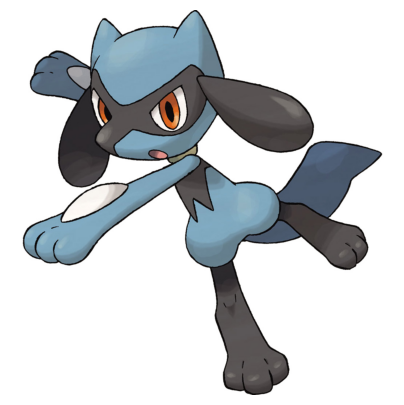

1. The creature is blue.
2. The creature looks unfriendly due to its intense stare and the way it is positioned with its arms outstretched, ready to pounce or defend itself.

---

 26%|██▋       | 53/200 [37:20<16:56,  6.92s/it]

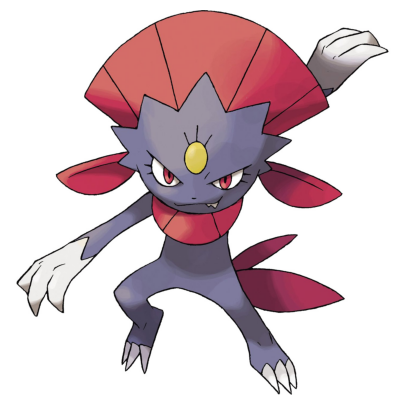

1. The creature is primarily blue with red accents.
2. The creature looks unfriendly due to its intense stare and the way its mouth is open, suggesting a growling or hissing sound.

---

 27%|██▋       | 54/200 [37:27<16:50,  6.92s/it]

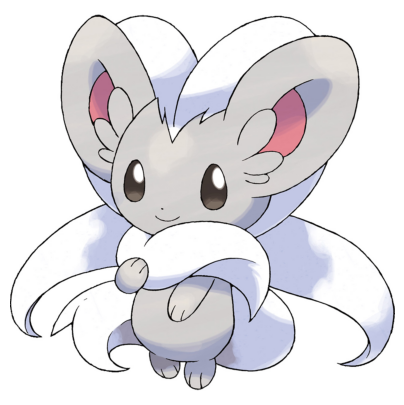

1. The creature is grey and white.
2. The creature looks friendly. It has a gentle expression with its eyes closed and a smile, which suggests a sense of contentment or happiness.

---

 28%|██▊       | 55/200 [37:34<16:22,  6.78s/it]

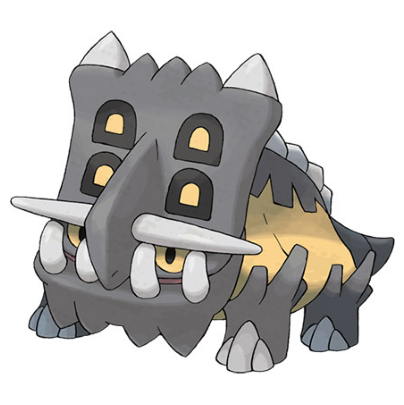

1. The creature is primarily grey with some yellow and black accents.
2. The creature looks unfriendly due to its sharp teeth and the overall aggressive stance it is portrayed with.

---

 28%|██▊       | 56/200 [37:40<16:03,  6.69s/it]

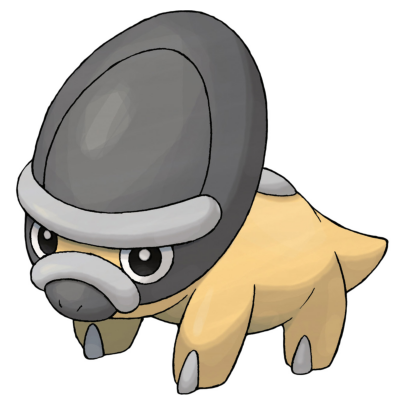

1. The creature is primarily yellow with some grey and black accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly. Its facial features are simple and not overly expressive, which could suggest a calm or neutral demeanor.

---

 28%|██▊       | 57/200 [37:49<17:35,  7.38s/it]

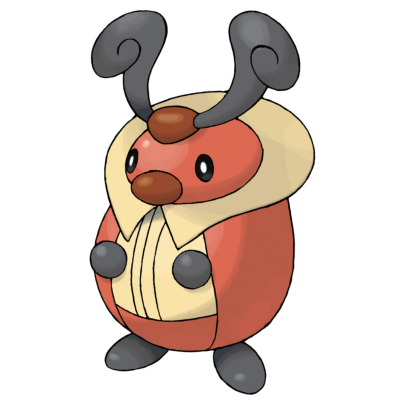

1. The creature is red.
2. The creature looks unfriendly due to its large, sharp horns and the fact that it has a menacing expression with its dark eyes and mouth.

---

 29%|██▉       | 58/200 [37:56<17:03,  7.21s/it]

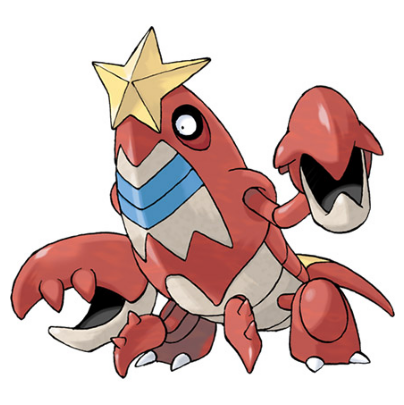

1. The creature is red and white.
2. The creature looks unfriendly due to its large size, sharp claws, and the menacing expression on its face.

---

 30%|██▉       | 59/200 [38:02<15:56,  6.79s/it]

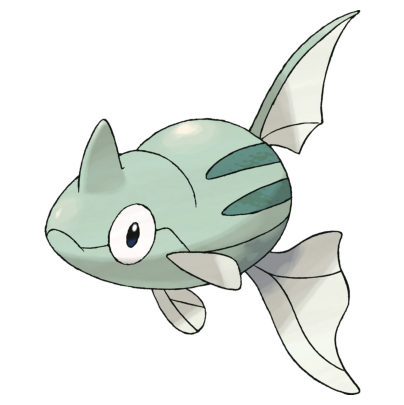

1. The creature is blue.
2. The creature looks friendly. It has a big, round body and a wide, smiling mouth, which often indicates a sense of happiness or contentment.

---

 30%|███       | 60/200 [38:08<15:17,  6.55s/it]

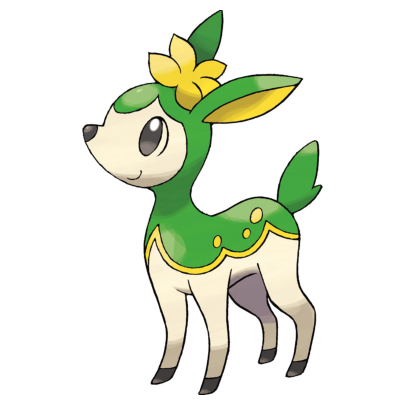

1. The creature is green and white.
2. The creature looks friendly. It has a big smile and its ears are perked up, which often indicates that an animal is happy or alert.

---

 30%|███       | 61/200 [38:13<14:12,  6.13s/it]

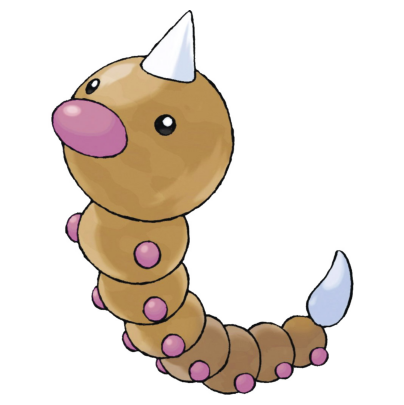

1. The creature is brown with pink spots.
2. The creature looks friendly, as it has a smiling face and a cute appearance.

---

 31%|███       | 62/200 [38:17<12:52,  5.60s/it]

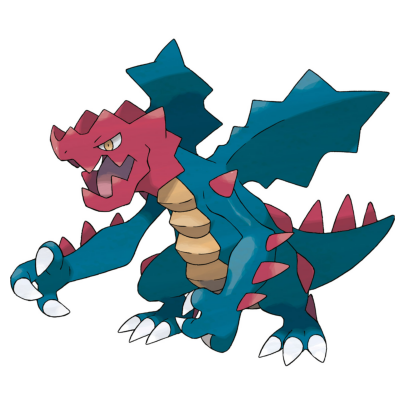

1. The creature is blue with red accents.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture it is in.

---

 32%|███▏      | 63/200 [38:22<12:16,  5.37s/it]

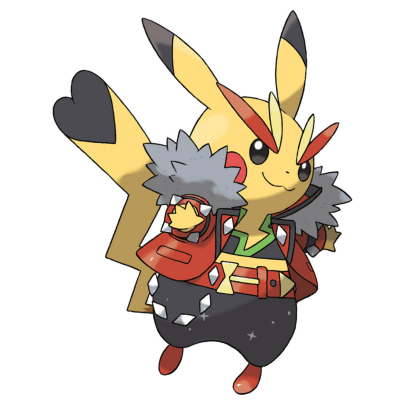

1. The creature is yellow with some red and black accents.
2. The creature looks friendly, with a big smile and a cheerful expression.

---

 32%|███▏      | 64/200 [38:27<11:30,  5.08s/it]

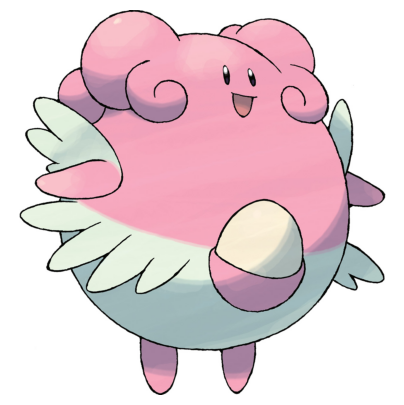

1. The creature is pink and white.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming and approachable.

---

 32%|███▎      | 65/200 [38:31<11:11,  4.97s/it]

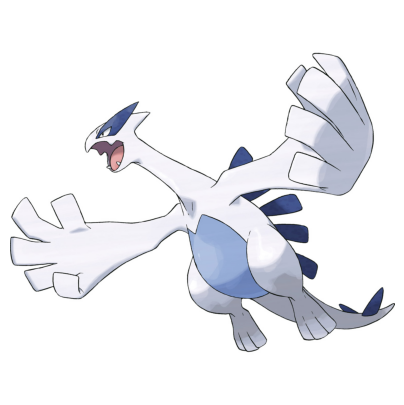

1. The creature is primarily white with blue accents.
2. The creature looks friendly, as it has a wide-open beak and a relaxed posture, suggesting it is not threatened or aggressive.

---

 33%|███▎      | 66/200 [38:37<11:39,  5.22s/it]

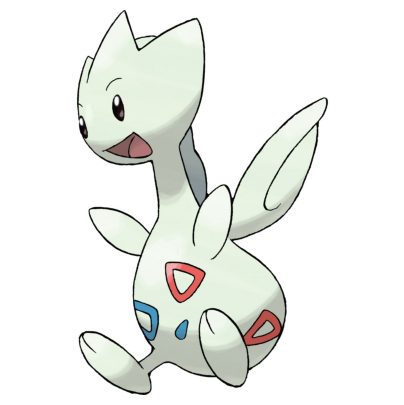

1. The creature is white with red, blue, and yellow accents.
2. The creature looks friendly, with a wide smile and a relaxed posture.

---

 34%|███▎      | 67/200 [38:42<11:06,  5.01s/it]

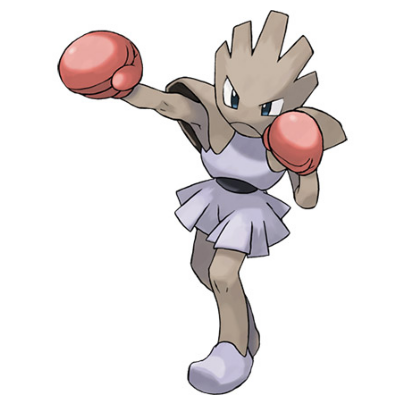

1. The creature is purple.
2. The creature looks friendly. It has a smiling expression and is wearing boxing gloves, which suggests a playful or sporty demeanor.

---

 34%|███▍      | 68/200 [38:47<11:15,  5.12s/it]

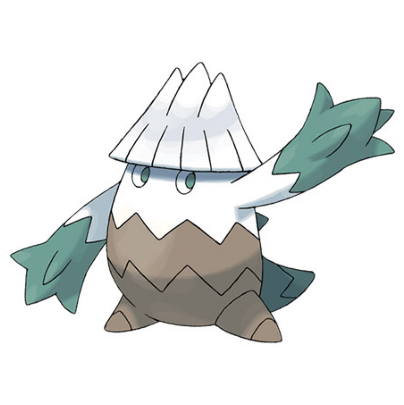

1. The creature is brown and white.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming and approachable.

---

 34%|███▍      | 69/200 [38:51<10:41,  4.89s/it]

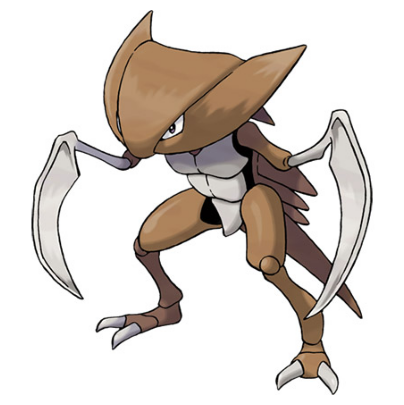

1. The creature is brown.
2. The creature looks unfriendly due to its sharp claws and the way it is positioned, ready to attack.

---

 35%|███▌      | 70/200 [38:55<10:03,  4.64s/it]

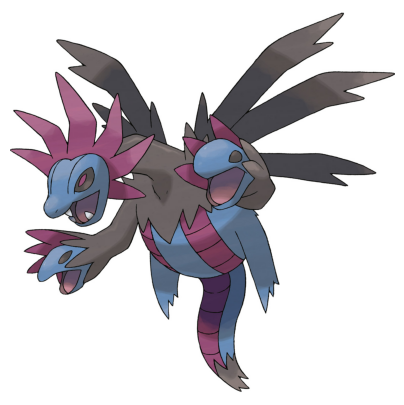

1. The creature is primarily blue with pink accents.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture of its wings.

---

 36%|███▌      | 71/200 [39:00<10:00,  4.65s/it]

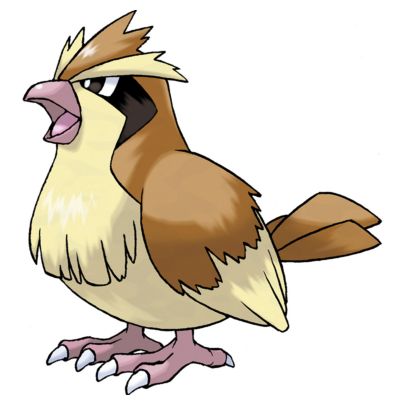

1. The creature is brown and white.
2. The creature looks unfriendly due to its sharp beak and claws, which are often associated with aggressive behavior in birds.

---

 36%|███▌      | 72/200 [39:05<09:48,  4.60s/it]

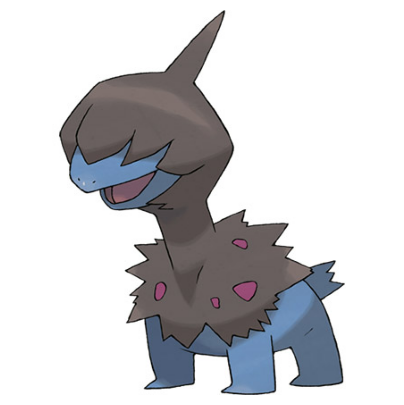

1. The creature is blue with pink spots.
2. The creature looks friendly, as it has a big smile and its body language suggests a relaxed and approachable demeanor.

---

 36%|███▋      | 73/200 [39:09<09:37,  4.55s/it]

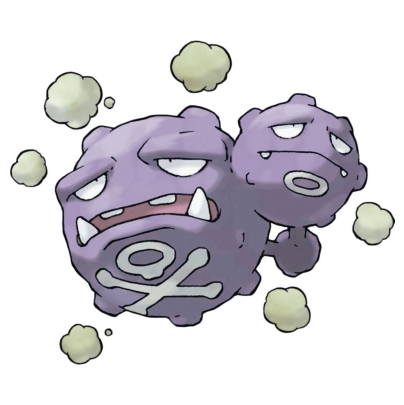

1. The creature is purple.
2. The creature looks unfriendly due to its large teeth and the angry expression on its face.

---

 37%|███▋      | 74/200 [39:13<08:53,  4.24s/it]

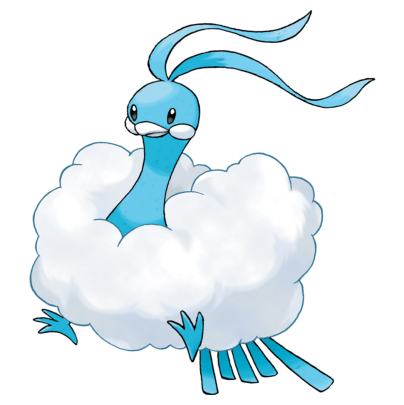

1. The creature is blue.
2. The creature looks friendly. It has a smiling expression and a relaxed posture, with its wings spread out and its body facing the viewer in a welcoming manner.

---

 38%|███▊      | 75/200 [39:18<09:15,  4.45s/it]

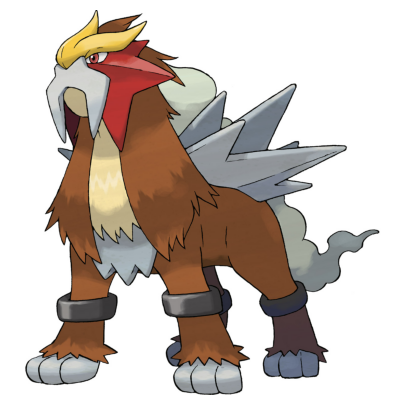

1. The creature is brown and red.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 38%|███▊      | 76/200 [39:22<08:54,  4.31s/it]

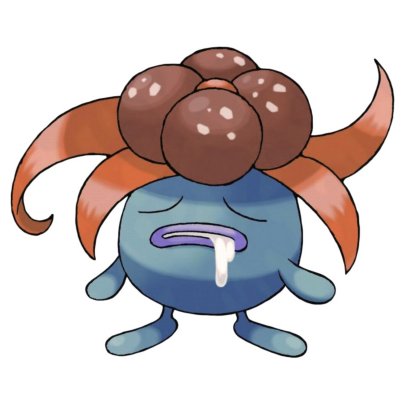

1. The creature is blue.
2. The creature looks unfriendly due to its sad facial expression and the drooping posture of its head, which can be interpreted as a sign of defeat or despair.

---

 38%|███▊      | 77/200 [39:27<09:24,  4.59s/it]

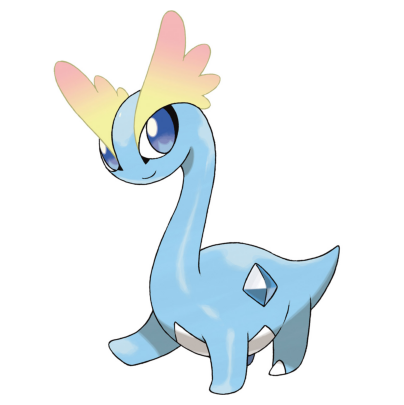

1. The creature is blue.
2. The creature looks friendly. It has a smiling expression and its body language is relaxed and open.

---

 39%|███▉      | 78/200 [39:30<08:47,  4.32s/it]

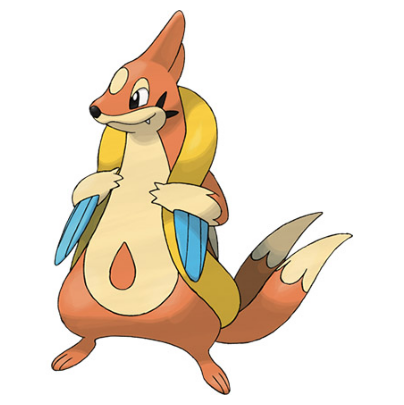

1. The creature is orange and yellow with blue wings.
2. The creature looks friendly, with a big smile and a relaxed posture.

---

 40%|███▉      | 79/200 [39:34<08:27,  4.19s/it]

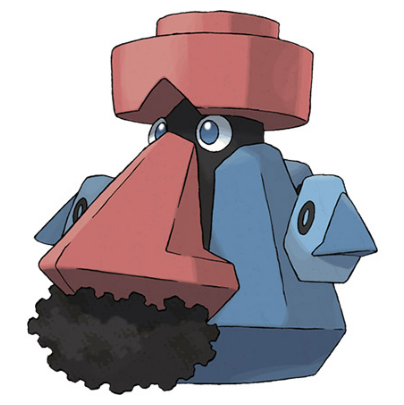

1. The creature is blue and red.
2. The creature looks unfriendly due to its large, sharp teeth and the intense expression on its face.

---

 40%|████      | 80/200 [39:39<08:22,  4.19s/it]

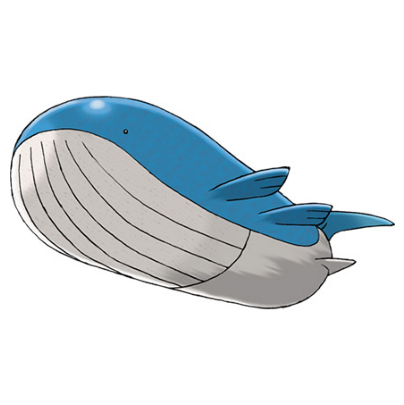

1. The creature is blue and white.
2. The creature looks friendly, as it has a smiling face and a welcoming posture.

---

 40%|████      | 81/200 [39:42<08:05,  4.08s/it]

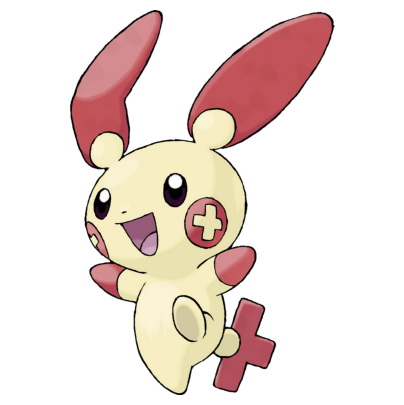

1. The creature is primarily yellow with red accents.
2. The creature looks friendly, as indicated by its wide smile and the red accents which often signify warmth or affection.

---

 41%|████      | 82/200 [39:47<08:27,  4.30s/it]

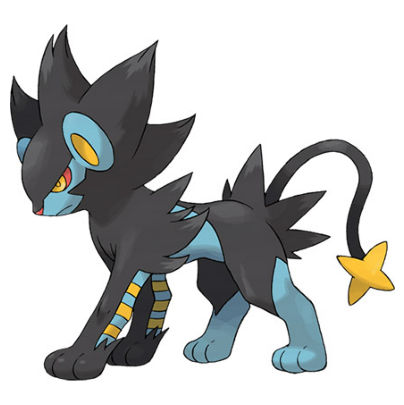

1. The creature is black and blue.
2. The creature looks unfriendly due to its sharp teeth and piercing eyes, which are often associated with predators or creatures that are dangerous to humans.

---

 42%|████▏     | 83/200 [39:52<08:52,  4.55s/it]

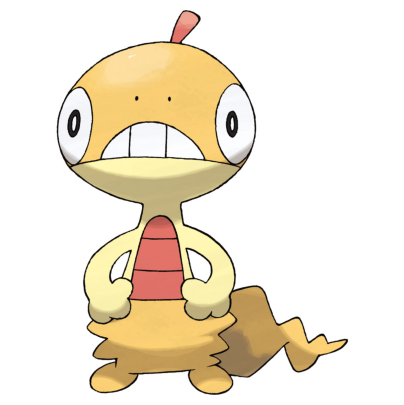

1. The creature is yellow.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 42%|████▏     | 84/200 [39:56<08:30,  4.40s/it]

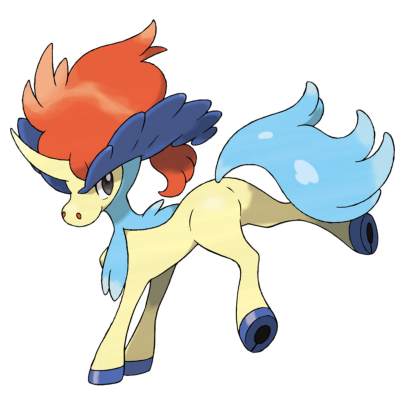

1. The creature is blue and yellow with red accents.
2. The creature looks friendly, with a gentle expression and a posture that suggests it is ready to engage with others.

---

 42%|████▎     | 85/200 [40:01<08:43,  4.55s/it]

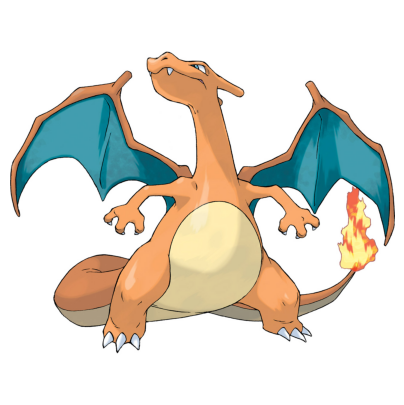

1. The creature is orange with blue wings.
2. The creature looks friendly, as it has a gentle expression and is depicted as a cartoon character, which often symbolizes warmth and approachability.

---

 43%|████▎     | 86/200 [40:06<08:55,  4.70s/it]

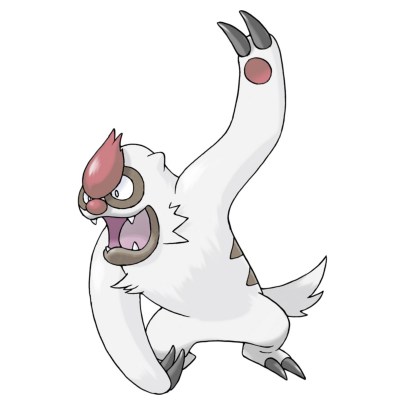

1. The creature is white.
2. The creature looks unfriendly due to its open mouth and the angry expression on its face.

---

 44%|████▎     | 87/200 [40:10<08:13,  4.37s/it]

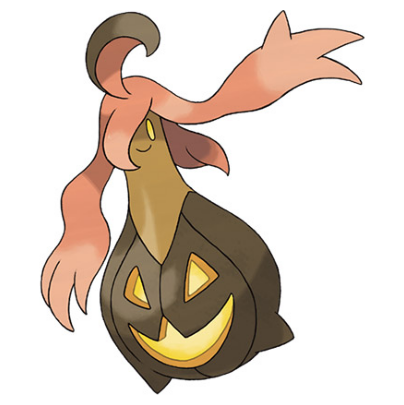

1. The creature is primarily brown with some pink and orange accents.
2. The creature has a friendly expression with a wide smile and a relaxed posture, suggesting it is not a threat.

---

 44%|████▍     | 88/200 [40:15<08:24,  4.50s/it]

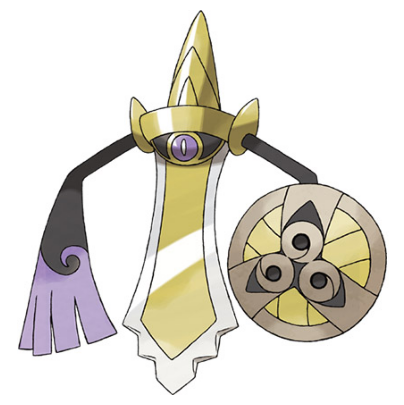

1. The creature is primarily yellow with some purple accents.
2. The creature has a neutral expression and does not appear to be overtly friendly or unfriendly. Its posture and the lack of any visible facial features make it difficult to discern its emotional state.

---

 44%|████▍     | 89/200 [40:21<09:32,  5.16s/it]

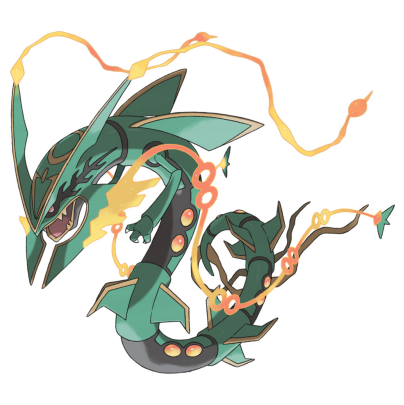

1. The creature is primarily green with some yellow and orange accents.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture of its body.

---

 45%|████▌     | 90/200 [40:26<09:09,  5.00s/it]

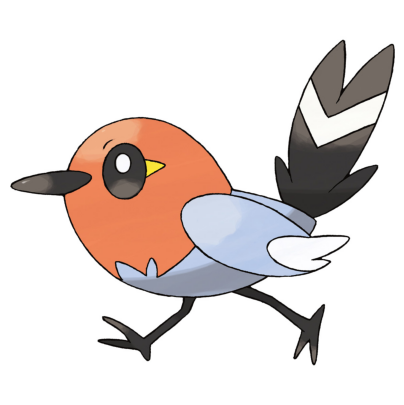

1. The creature is primarily orange with some blue and black accents.
2. The creature has a friendly appearance, with a wide smile and a relaxed posture.

---

 46%|████▌     | 91/200 [40:30<08:39,  4.77s/it]

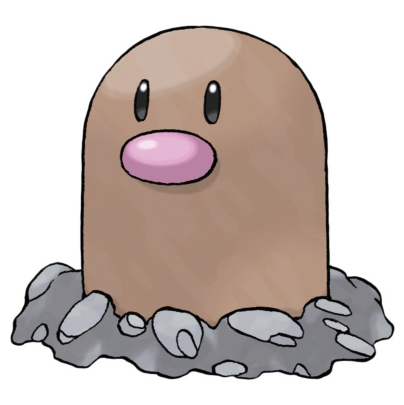

1. The creature is brown.
2. The creature looks friendly. It has a big smile and a round, inviting shape that suggests it is approachable.

---

 46%|████▌     | 92/200 [40:34<08:09,  4.53s/it]

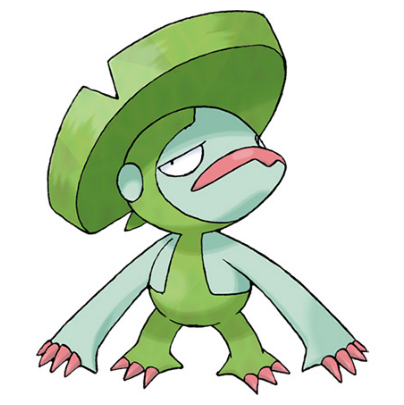

1. The creature is green.
2. The creature looks unfriendly due to its facial expression, which appears to be a scowl or frown.

---

 46%|████▋     | 93/200 [40:38<07:49,  4.39s/it]

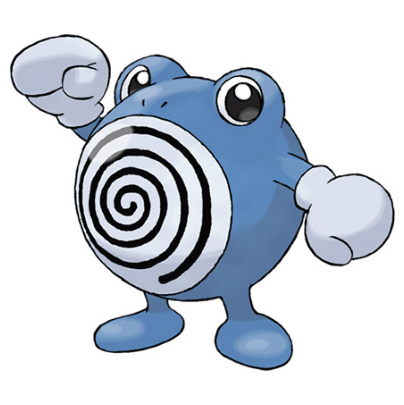

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its arms are outstretched in a welcoming gesture.

---

 47%|████▋     | 94/200 [40:42<07:32,  4.27s/it]

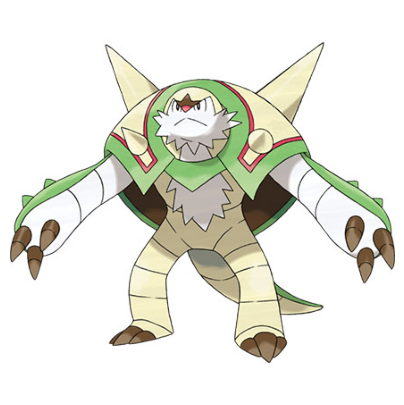

1. The creature is primarily green and white.
2. The creature looks unfriendly due to its frowning facial expression and the sharpness of its claws and teeth, which could be perceived as a threat.

---

 48%|████▊     | 95/200 [40:48<08:01,  4.59s/it]

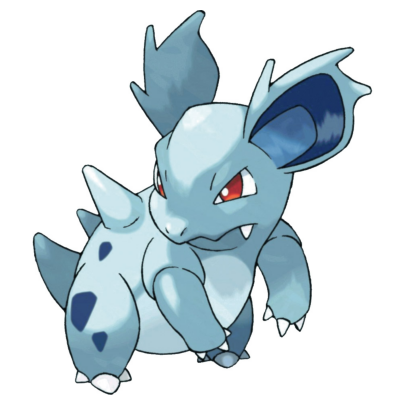

1. The creature is blue.
2. The creature looks unfriendly due to its intense red eyes and the way its mouth is open, suggesting it might be growling or hissing.

---

 48%|████▊     | 96/200 [40:52<08:04,  4.66s/it]

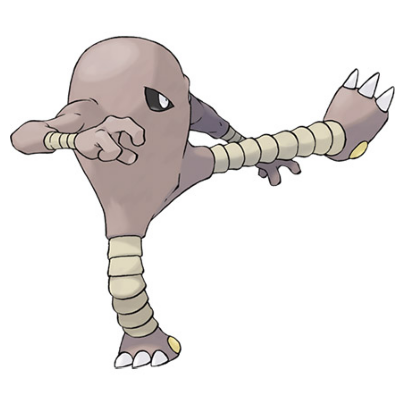

1. The creature is brown.
2. The creature looks unfriendly due to its facial expression and the way it is positioned with its arms outstretched and its mouth open, which could be interpreted as a threatening gesture.

---

 48%|████▊     | 97/200 [40:58<08:37,  5.02s/it]

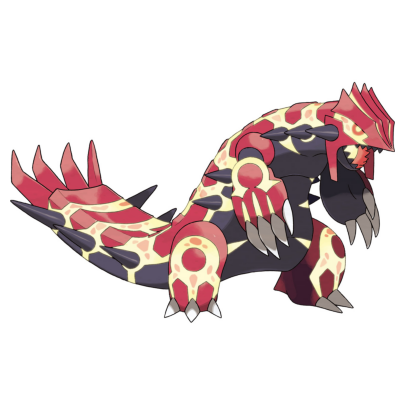

1. The creature is primarily red and black with some yellow and orange accents.
2. The creature looks unfriendly due to its sharp teeth, claws, and the aggressive posture it is in.

---

 49%|████▉     | 98/200 [41:04<08:42,  5.12s/it]

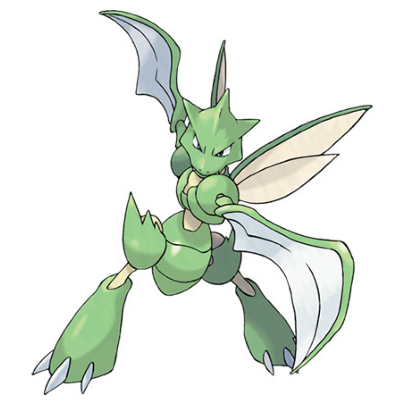

1. The creature is green.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 50%|████▉     | 99/200 [41:07<07:57,  4.73s/it]

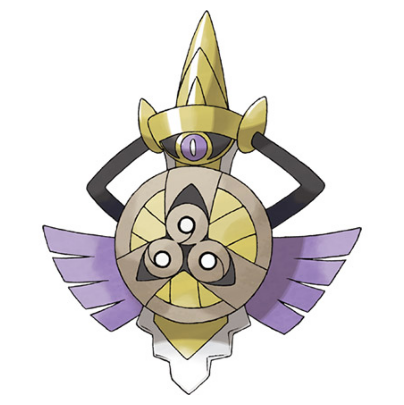

1. The creature is primarily yellow with some black accents.
2. The creature has a neutral expression and a posture that suggests it is ready to engage with others.

---

 50%|█████     | 100/200 [41:12<07:37,  4.58s/it]

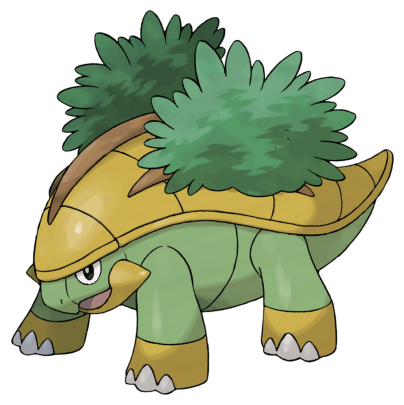

1. The creature is green.
2. The creature looks friendly. It has a smiling expression and its body language suggests a relaxed and approachable demeanor.

---

 50%|█████     | 101/200 [41:16<07:24,  4.49s/it]

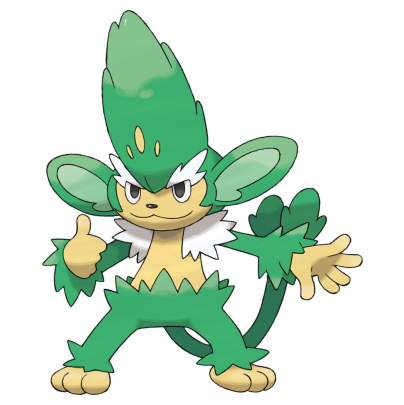

1. The creature is green.
2. The creature looks unfriendly due to its facial expression and the way it is standing with its arms outstretched.

---

 51%|█████     | 102/200 [41:20<07:12,  4.41s/it]

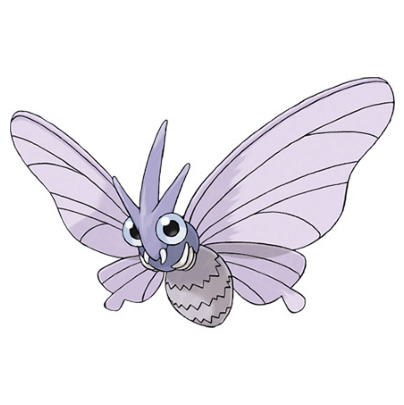

1. The creature is purple.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 52%|█████▏    | 103/200 [41:24<06:54,  4.28s/it]

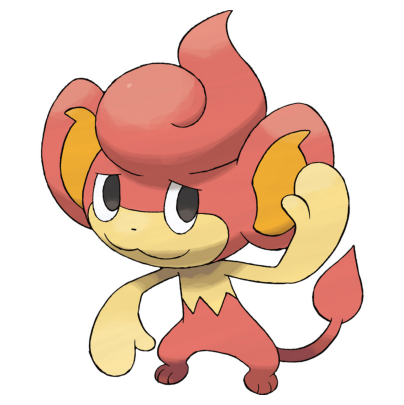

1. The creature is primarily red with some yellow and orange accents.
2. The creature has a friendly expression with a slight smile and wide eyes, which suggests it is approachable and possibly curious or playful.

---

 52%|█████▏    | 104/200 [41:29<07:18,  4.57s/it]

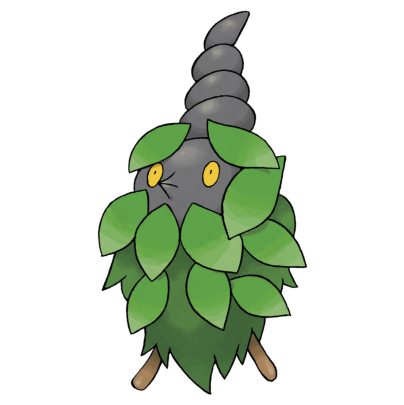

1. The creature is primarily green with some gray and yellow accents.
2. The creature has a somewhat unfriendly appearance due to its large, overgrown leaves and the fact that it is depicted with a frown.

---

 52%|█████▎    | 105/200 [41:35<07:48,  4.93s/it]

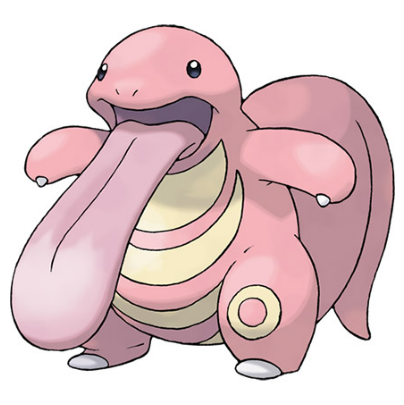

1. The creature is pink.
2. The creature looks friendly. Its large eyes and open mouth suggest a welcoming demeanor, and the overall design of the creature is cute and inviting.

---

 53%|█████▎    | 106/200 [41:40<07:50,  5.01s/it]

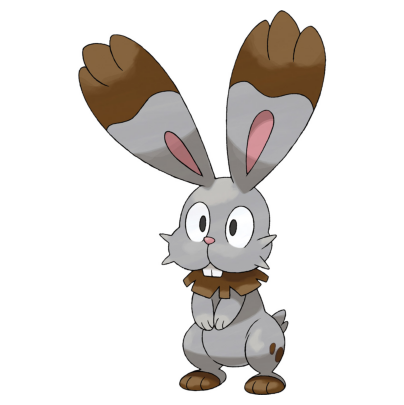

1. The creature is grey with brown ears and a brown nose.
2. The creature looks friendly, with a wide smile and a relaxed posture.

---

 54%|█████▎    | 107/200 [41:44<07:20,  4.74s/it]

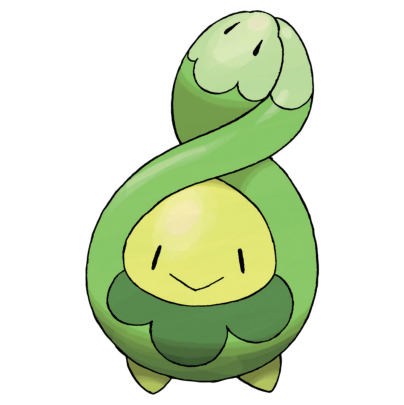

1. The creature is green.
2. The creature looks friendly. It has a big smile and a relaxed posture, which often indicates a sense of trust and comfort.

---

 54%|█████▍    | 108/200 [41:49<07:10,  4.68s/it]

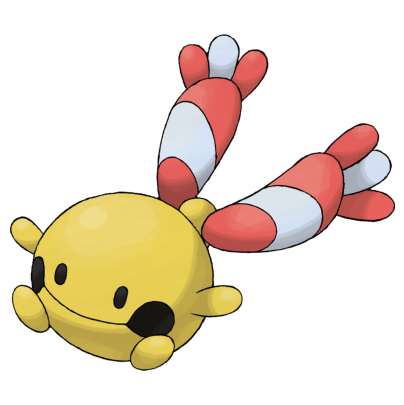

1. The creature is yellow with red and white accents.
2. The creature looks friendly, as it has a smiling face and a cheerful expression.

---

 55%|█████▍    | 109/200 [41:53<06:58,  4.60s/it]

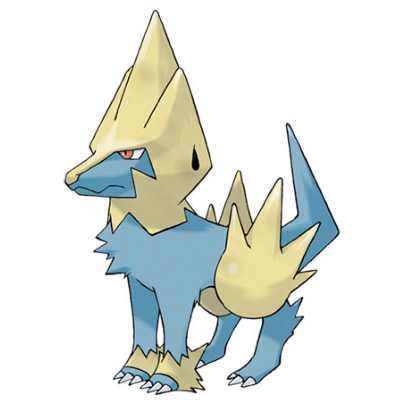

1. The creature is blue and yellow.
2. The creature looks unfriendly due to its sharp teeth and the intense red eyes.

---

 55%|█████▌    | 110/200 [41:57<06:35,  4.39s/it]

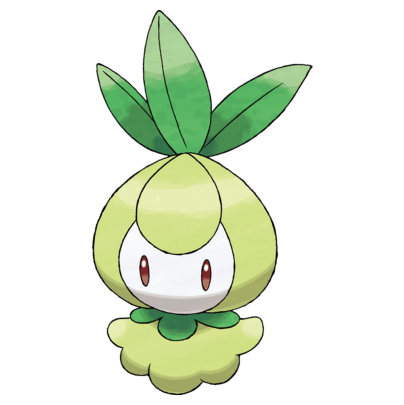

1. The creature is green and white.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming and approachable.

---

 56%|█████▌    | 111/200 [42:02<06:30,  4.39s/it]

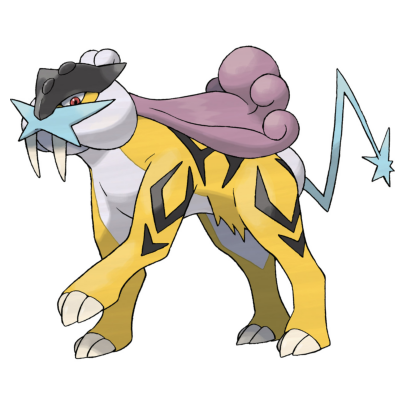

1. The creature is yellow and white.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 56%|█████▌    | 112/200 [42:06<06:22,  4.34s/it]

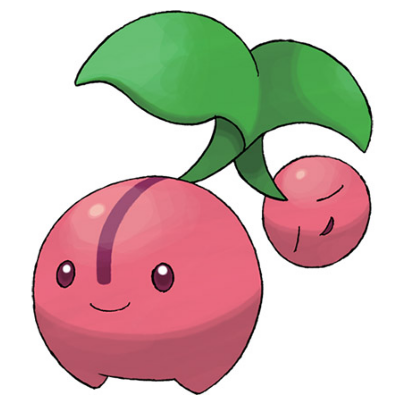

1. The creature is pink.
2. The creature looks friendly. It has a smiling face and a relaxed posture, suggesting it is not threatened or aggressive.

---

 56%|█████▋    | 113/200 [42:11<06:28,  4.46s/it]

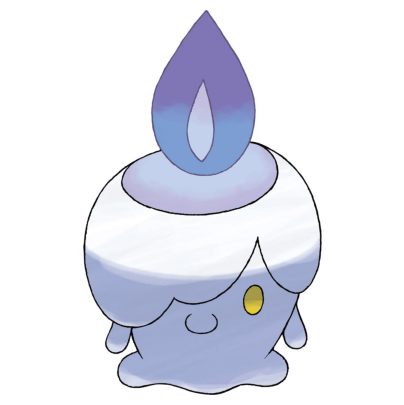

1. The creature is purple and white.
2. The creature looks friendly. It has a smiling face and a cheerful expression, which often indicates a positive and approachable demeanor.

---

 57%|█████▋    | 114/200 [42:16<06:39,  4.64s/it]

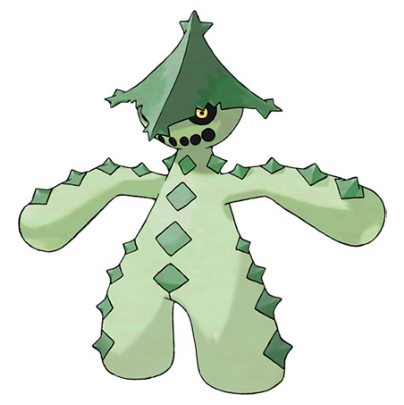

1. The creature is green.
2. The creature looks unfriendly due to its sharp spikes and the fact that it has a menacing expression with its mouth open and yellow eyes.

---

 57%|█████▊    | 115/200 [42:21<06:39,  4.71s/it]

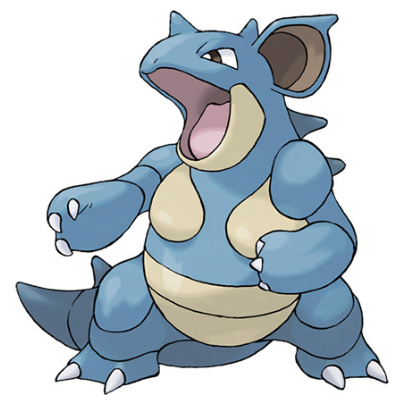

1. The creature is blue.
2. The creature looks friendly. It has a wide open mouth, which is often associated with a smile or a sign of friendliness in many cultures. Additionally, the creature's body language, with its arms outstretched and its posture relaxed, suggests a welcoming and non-threatening demeanor.

---

 58%|█████▊    | 116/200 [42:30<08:21,  5.97s/it]

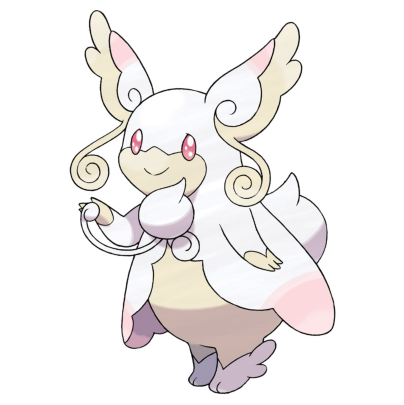

1. The creature is white and pink.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming or happy to see someone.

---

 58%|█████▊    | 117/200 [42:34<07:45,  5.61s/it]

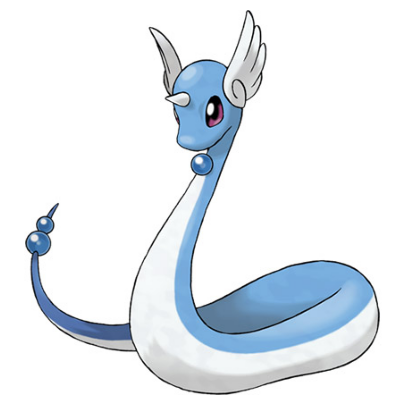

1. The creature is blue and white.
2. The creature looks friendly. It has a smiling expression and its body language is relaxed, with its head turned slightly to the side and its body curled in a welcoming manner.

---

 59%|█████▉    | 118/200 [42:40<07:45,  5.68s/it]

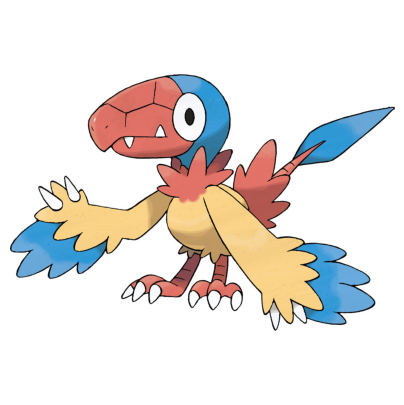

1. The creature is primarily blue with red and yellow accents.
2. The creature looks friendly, with a wide smile and outstretched wings, suggesting a welcoming or playful demeanor.

---

 60%|█████▉    | 119/200 [42:46<07:32,  5.59s/it]

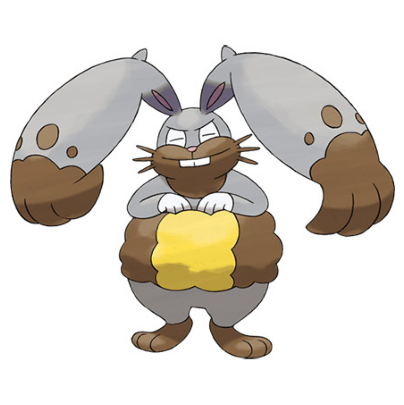

1. The creature is grey with brown spots.
2. The creature looks unfriendly due to its facial expression and the way it is holding its arms.

---

 60%|██████    | 120/200 [42:50<06:56,  5.21s/it]

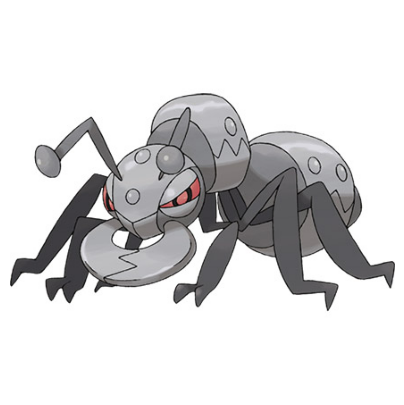

1. The creature is primarily black with some red and white accents.
2. The creature looks unfriendly due to its large size, sharp teeth, and the red eyes which can be interpreted as a threat or aggression.

---

 60%|██████    | 121/200 [42:56<07:12,  5.47s/it]

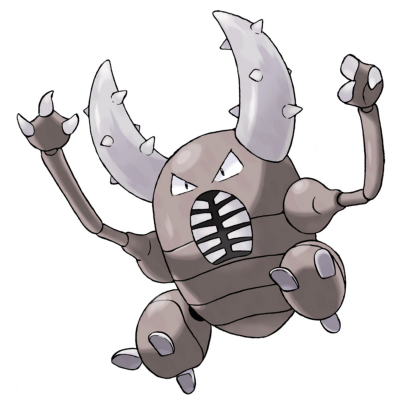

1. The creature is primarily grey with some white and black accents.
2. The creature looks unfriendly due to its aggressive posture, with its mouth open and its eyes appearing to be glowing with a fiery red hue. This, combined with its sharp, spiky horns and claws, suggests that it is a formidable and potentially dangerous creature.

---

 61%|██████    | 122/200 [43:06<08:50,  6.80s/it]

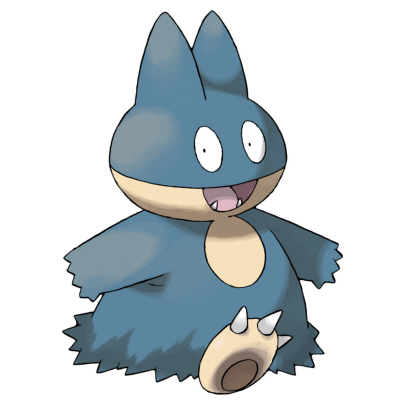

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming or happy to see someone.

---

 62%|██████▏   | 123/200 [43:10<07:49,  6.10s/it]

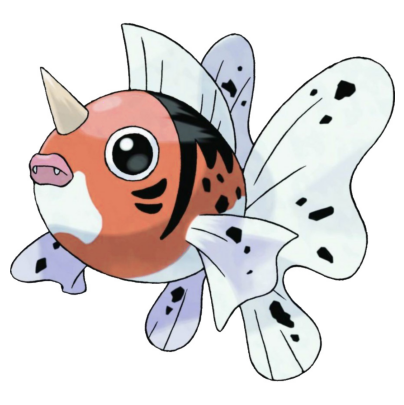

1. The creature is primarily orange with black and white spots.
2. The creature looks friendly, as it has a wide smile and a relaxed posture.

---

 62%|██████▏   | 124/200 [43:15<07:05,  5.60s/it]

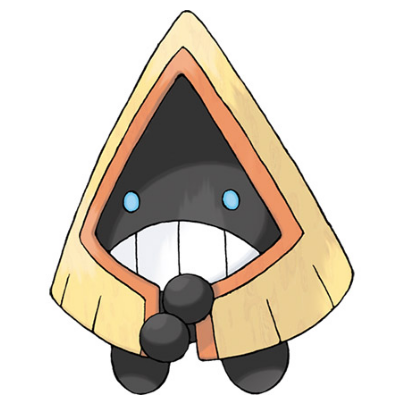

1. The creature is primarily orange with some black accents.
2. The creature has a friendly expression with a wide smile and blue eyes, which suggests it is approachable and possibly curious or playful.

---

 62%|██████▎   | 125/200 [43:20<06:51,  5.49s/it]

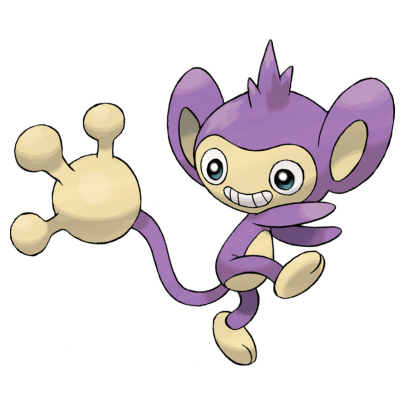

1. The creature is purple.
2. The creature looks friendly. It has a big smile and its body language suggests it is in a playful or joyful mood.

---

 63%|██████▎   | 126/200 [43:25<06:35,  5.34s/it]

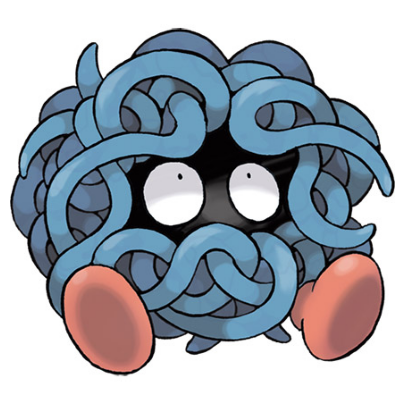

1. The creature is blue.
2. The creature looks unfriendly due to its large, menacing eyes and the way its tentacles are swirling around it, giving it a threatening appearance.

---

 64%|██████▎   | 127/200 [43:30<06:34,  5.40s/it]

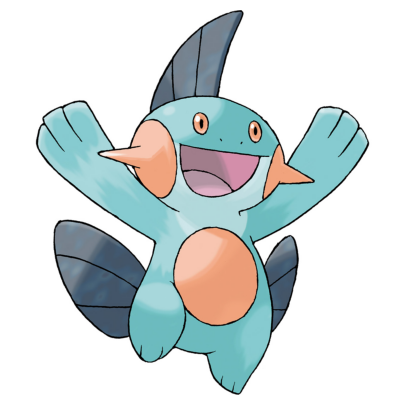

1. The creature is blue.
2. The creature looks very friendly. It has a big smile and its arms are outstretched in a welcoming gesture.

---

 64%|██████▍   | 128/200 [43:35<06:13,  5.18s/it]

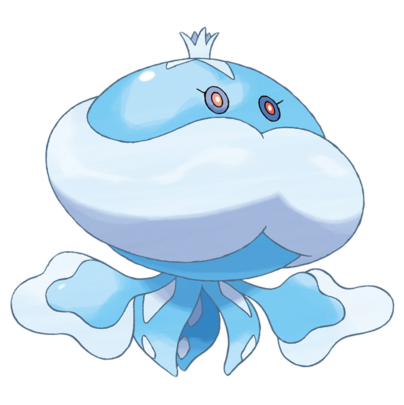

1. The creature is blue.
2. The creature looks friendly. It has a big smile and a crown, which suggests it is royal and might be kind.

---

 64%|██████▍   | 129/200 [43:40<05:54,  4.99s/it]

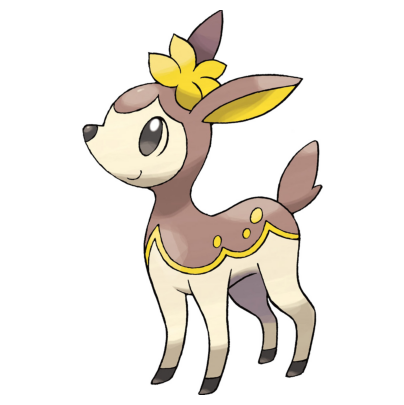

1. The creature is brown and white.
2. The creature looks friendly. It has a big smile and its ears are perked up, which often indicates that an animal is happy or alert.

---

 65%|██████▌   | 130/200 [43:45<05:54,  5.06s/it]

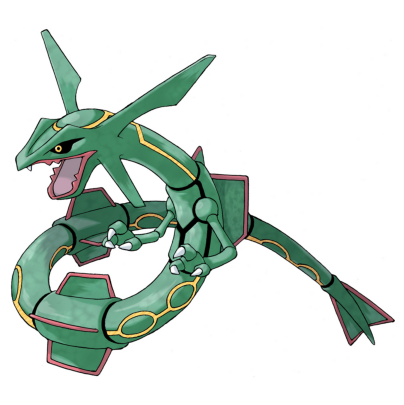

1. The creature is green.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture of its body.

---

 66%|██████▌   | 131/200 [43:49<05:35,  4.86s/it]

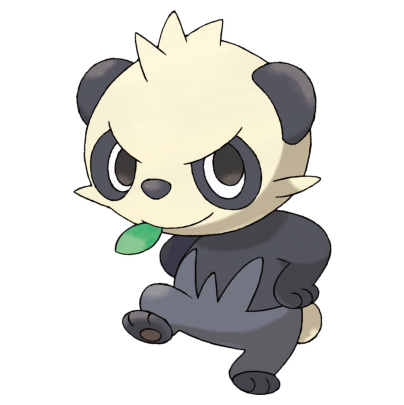

1. The creature is primarily white with black markings.
2. The creature looks unfriendly due to its intense stare and the way its mouth is open, which can be interpreted as a snarl or a growl.

---

 66%|██████▌   | 132/200 [43:56<06:00,  5.30s/it]

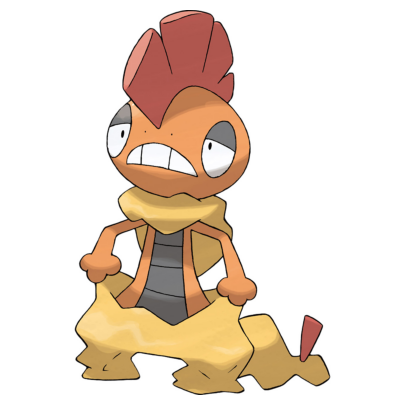

1. The creature is orange with some red and yellow accents.
2. The creature looks unfriendly due to its wide-eyed expression and open mouth, which can be interpreted as a scream or a shout.

---

 66%|██████▋   | 133/200 [44:02<06:09,  5.51s/it]

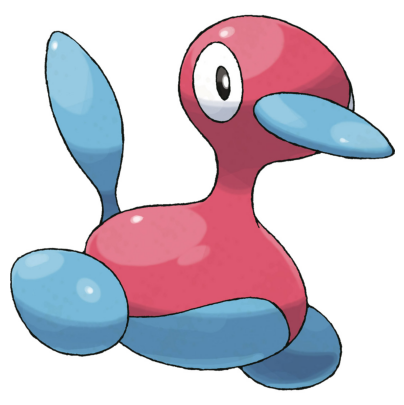

1. The creature is pink and blue.
2. The creature looks friendly. Its facial expression is neutral and it has a soft, rounded body shape that is often associated with friendly characters.

---

 67%|██████▋   | 134/200 [44:07<06:03,  5.50s/it]

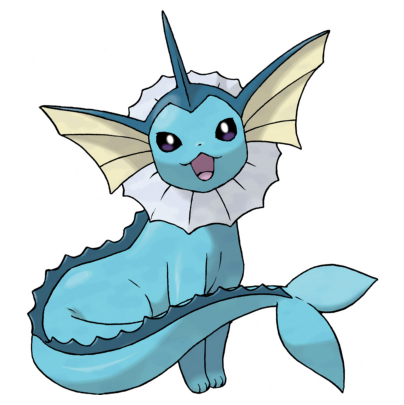

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its eyes are wide open, which can indicate happiness or excitement.

---

 68%|██████▊   | 135/200 [44:12<05:43,  5.28s/it]

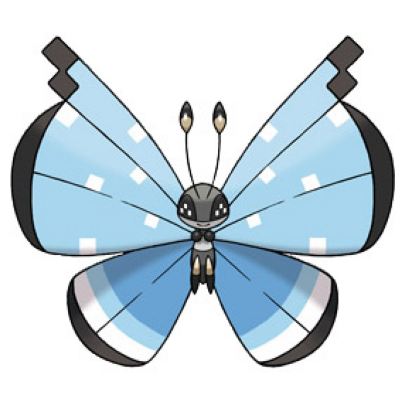

1. The creature is blue with white spots.
2. The creature looks friendly, as it has a smiling expression and is depicted as a cartoon character, which often symbolizes warmth and approachability.

---

 68%|██████▊   | 136/200 [44:18<05:48,  5.45s/it]

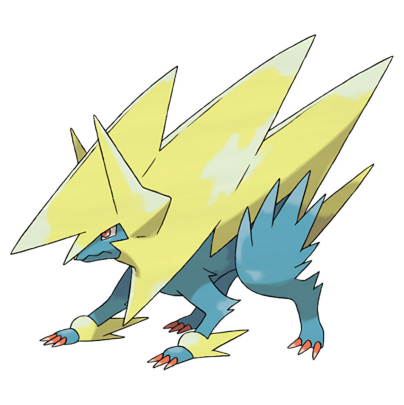

1. The creature is primarily yellow with some blue accents.
2. The creature looks unfriendly due to its sharp teeth and the intense expression on its face.

---

 68%|██████▊   | 137/200 [44:23<05:31,  5.25s/it]

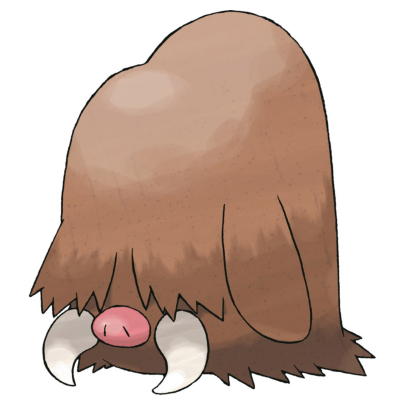

1. The creature is brown.
2. The creature looks unfriendly due to its large size, sharp tusks, and the overall aggressive appearance of its body language.

---

 69%|██████▉   | 138/200 [44:28<05:21,  5.19s/it]

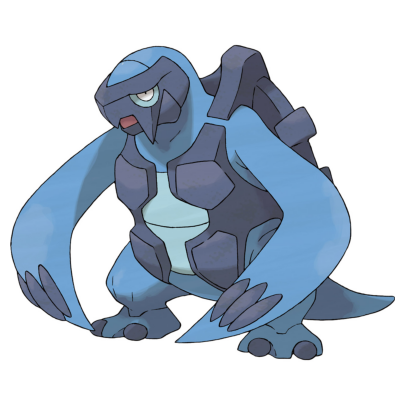

1. The creature is blue.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 70%|██████▉   | 139/200 [44:32<05:00,  4.93s/it]

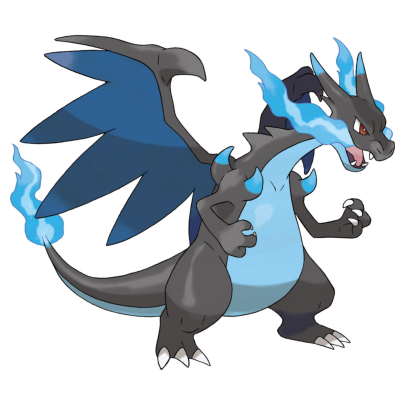

1. The creature is blue and black.
2. The creature looks unfriendly due to its fierce expression and the fact that it has its mouth open, which could indicate aggression or a battle cry.

---

 70%|███████   | 140/200 [44:38<05:08,  5.15s/it]

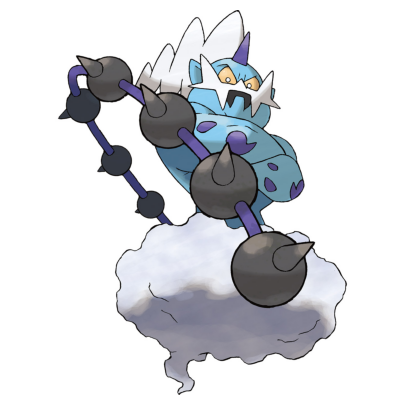

1. The creature is blue and white.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 70%|███████   | 141/200 [44:42<04:53,  4.98s/it]

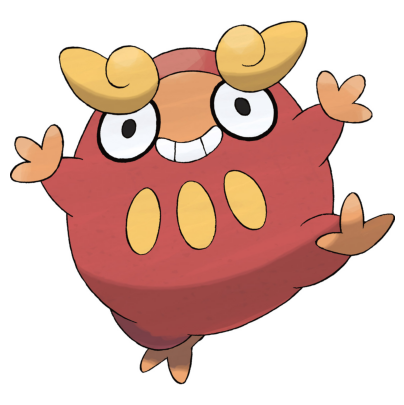

1. The creature is red.
2. The creature looks friendly. It has a big smile and its arms are outstretched in a welcoming gesture.

---

 71%|███████   | 142/200 [44:47<04:43,  4.88s/it]

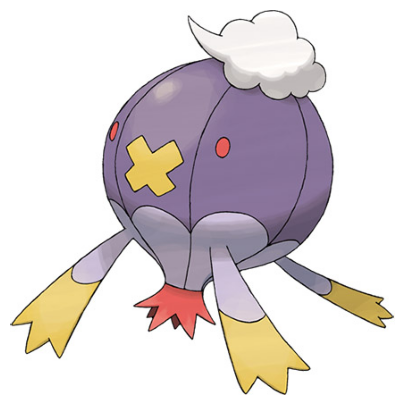

1. The creature is purple with yellow and red accents.
2. The creature looks friendly, as it has a smiling face and a cheerful expression.

---

 72%|███████▏  | 143/200 [44:51<04:33,  4.79s/it]

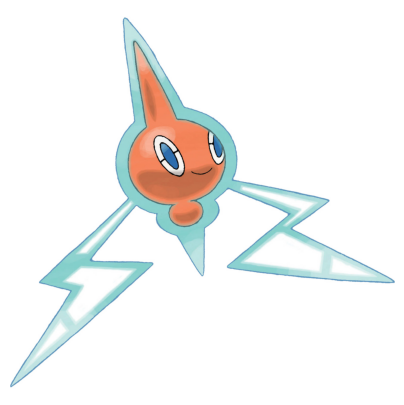

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its body language suggests it is approachable.

---

 72%|███████▏  | 144/200 [44:56<04:18,  4.62s/it]

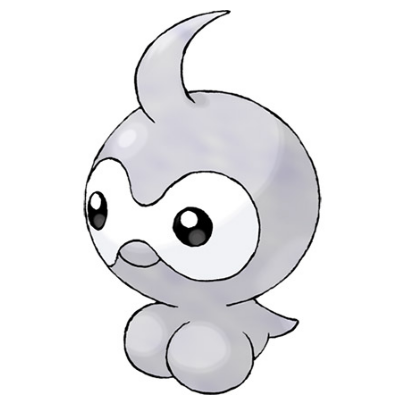

1. The creature is grey.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 72%|███████▎  | 145/200 [45:00<04:10,  4.55s/it]

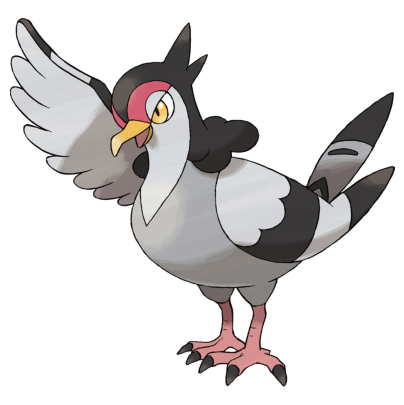

1. The creature is black and white with a red patch on its head.
2. The creature looks friendly, with a wide-eyed expression and an open beak, suggesting it might be singing or calling out to others.

---

 73%|███████▎  | 146/200 [45:06<04:33,  5.07s/it]

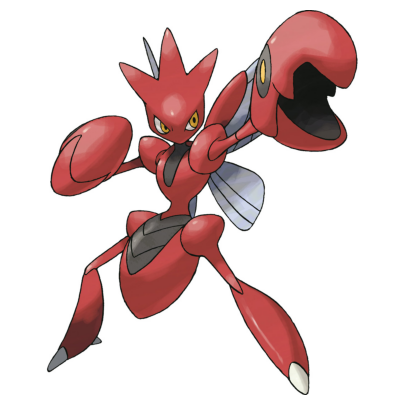

1. The creature is red.
2. The creature looks friendly. It has a wide smile and its body language suggests a welcoming or playful demeanor.

---

 74%|███████▎  | 147/200 [45:11<04:25,  5.00s/it]

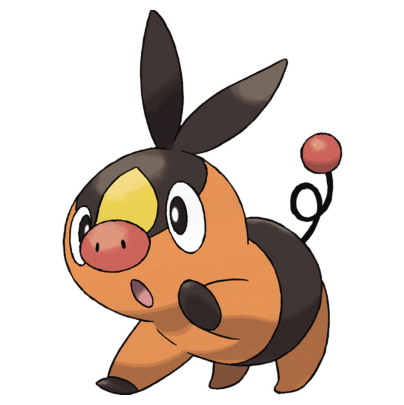

1. The creature is orange with black ears and a black nose.
2. The creature looks friendly, with a big smile and a relaxed posture.

---

 74%|███████▍  | 148/200 [45:16<04:12,  4.86s/it]

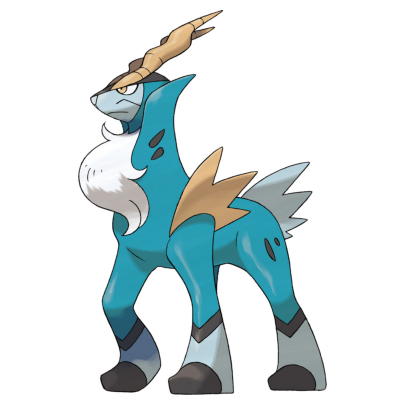

1. The creature is blue.
2. The creature looks unfriendly. It has a stern expression and its body language is stiff and upright, which can be interpreted as defensive or aggressive.

---

 74%|███████▍  | 149/200 [45:22<04:28,  5.26s/it]

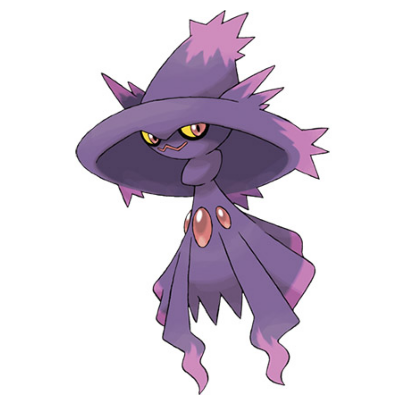

1. The creature is purple.
2. The creature looks unfriendly due to its large, sharp teeth and the intense glare of its eyes.

---

 75%|███████▌  | 150/200 [45:27<04:16,  5.12s/it]

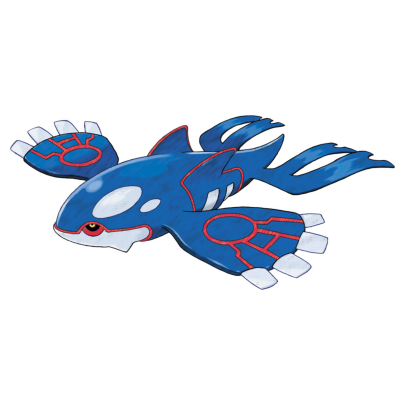

1. The creature is blue.
2. The creature looks friendly. It has a smiling face and a welcoming posture, with its arms outstretched as if to embrace or greet someone.

---

 76%|███████▌  | 151/200 [45:33<04:27,  5.46s/it]

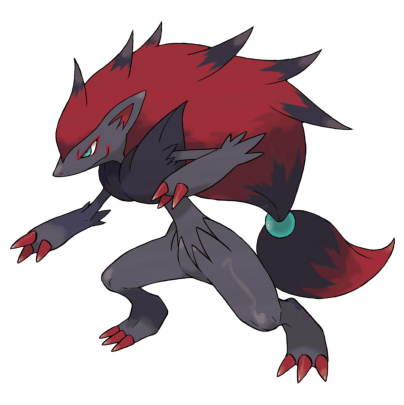

1. The creature is primarily red and black.
2. The creature looks unfriendly due to its sharp teeth and the aggressive stance it is in.

---

 76%|███████▌  | 152/200 [45:38<04:14,  5.30s/it]

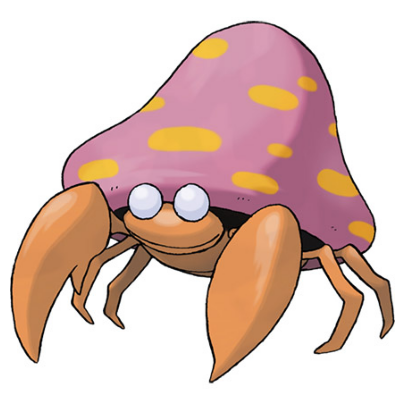

1. The creature is purple with yellow spots.
2. The creature looks friendly, as it has a smiling expression and is wearing a cute hat.

---

 76%|███████▋  | 153/200 [45:43<04:05,  5.22s/it]

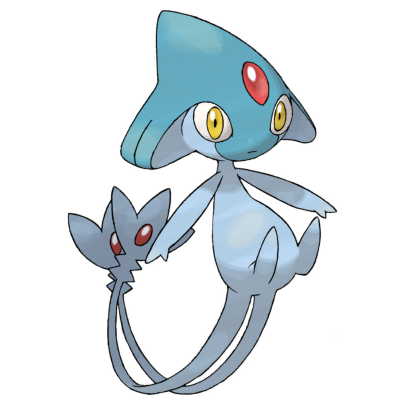

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its body language suggests it is welcoming or happy.

---

 77%|███████▋  | 154/200 [45:48<03:52,  5.05s/it]

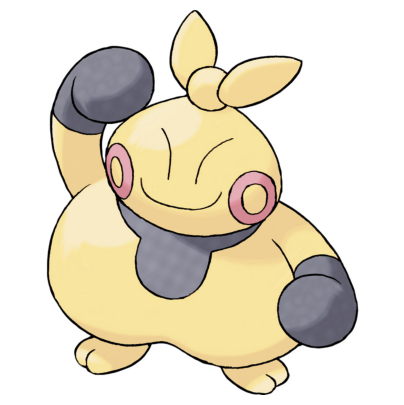

1. The creature is yellow.
2. The creature looks friendly. It has a big smile and its arms are raised in a welcoming gesture.

---

 78%|███████▊  | 155/200 [45:52<03:42,  4.95s/it]

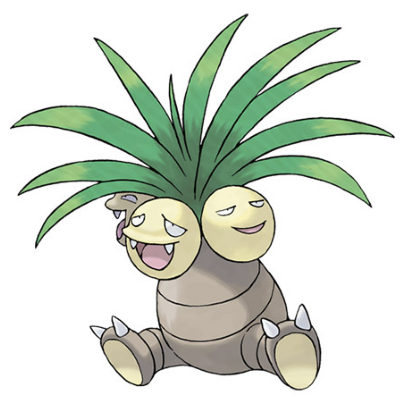

1. The creature is green.
2. The creature looks friendly. It has a smiling face and a relaxed posture, suggesting it is not a threat.

---

 78%|███████▊  | 156/200 [45:57<03:39,  4.99s/it]

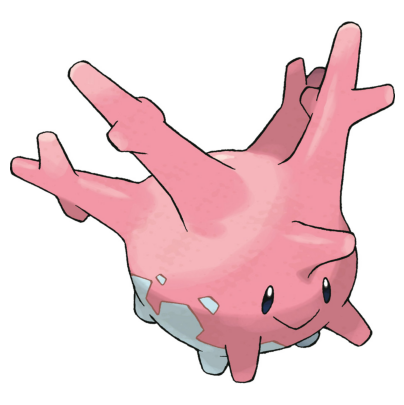

1. The creature is pink.
2. The creature looks friendly. It has a big smile and its body language suggests a relaxed and approachable demeanor.

---

 78%|███████▊  | 157/200 [46:03<03:38,  5.08s/it]

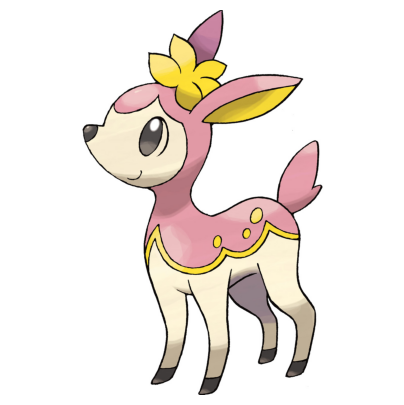

1. The creature is pink with yellow accents.
2. The creature looks friendly, as it has a smiling expression and is depicted in a cute, cartoonish style.

---

 79%|███████▉  | 158/200 [46:08<03:43,  5.32s/it]

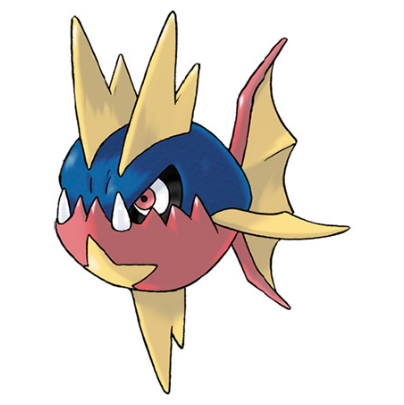

1. The creature is primarily blue with yellow fins and a pink body.
2. The creature looks unfriendly due to its large, sharp teeth and the angry expression on its face.

---

 80%|███████▉  | 159/200 [46:14<03:40,  5.37s/it]

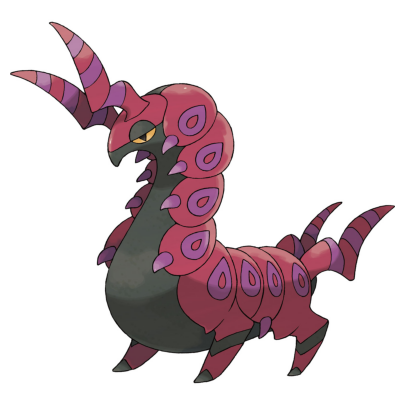

1. The creature is predominantly pink with purple accents.
2. The creature looks unfriendly due to its large size, sharp teeth, and the overall aggressive posture.

---

 80%|████████  | 160/200 [46:20<03:39,  5.49s/it]

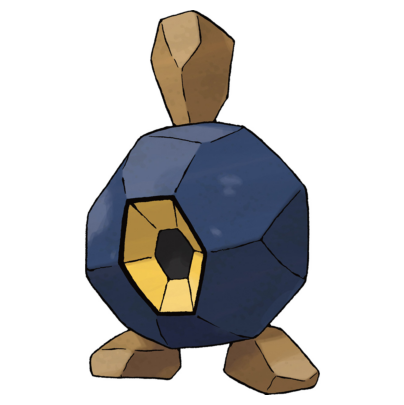

1. The creature is blue.
2. The creature looks unfriendly due to its large size, sharp edges, and the presence of a large, dark hole in the center.

---

 80%|████████  | 161/200 [46:25<03:30,  5.40s/it]

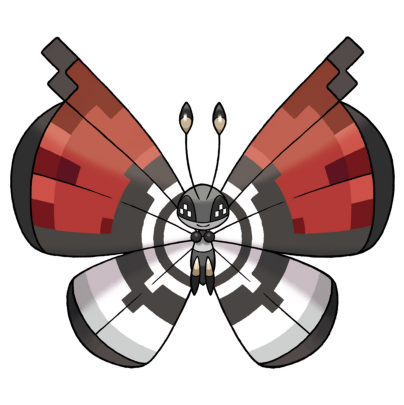

1. The creature is primarily red and black with some white accents.
2. The creature has a somewhat unfriendly appearance, with a stern expression and sharp, pointed features.

---

 81%|████████  | 162/200 [46:30<03:21,  5.30s/it]

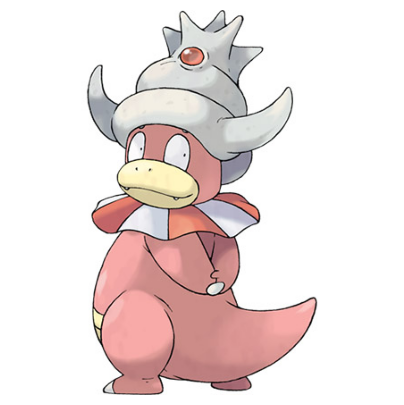

1. The creature is pink.
2. The creature looks friendly. It has a big smile and a cheerful expression, which often indicates a friendly demeanor.

---

 82%|████████▏ | 163/200 [46:35<03:10,  5.15s/it]

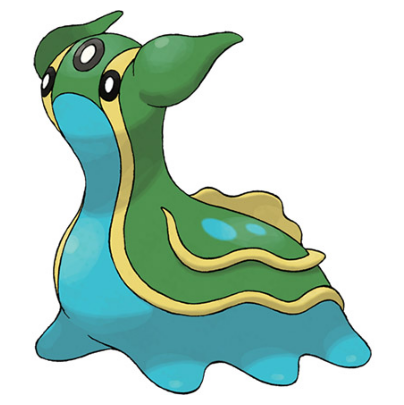

1. The creature is primarily blue with yellow and green accents.
2. The creature has a friendly appearance, with a wide smile and a relaxed posture. Its bright colors and expressive features suggest that it is meant to be appealing and approachable.

---

 82%|████████▏ | 164/200 [46:42<03:24,  5.69s/it]

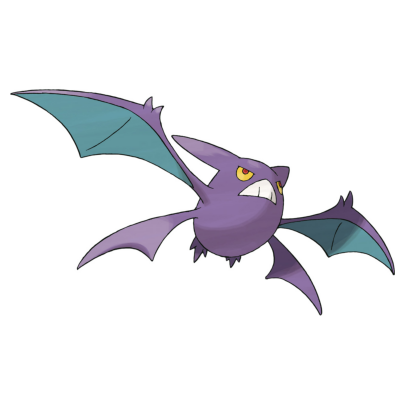

1. The creature is purple.
2. The creature looks unfriendly due to its sharp teeth and the angry expression on its face.

---

 82%|████████▎ | 165/200 [46:46<03:03,  5.26s/it]

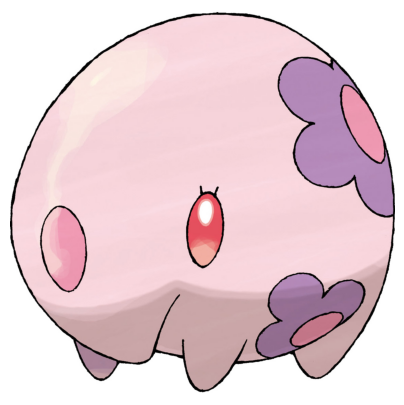

1. The creature is pink.
2. The creature looks friendly. It has a big, round body with a smiling face and a big, round eye. The overall shape and appearance of the creature is cute and inviting.

---

 83%|████████▎ | 166/200 [46:53<03:11,  5.64s/it]

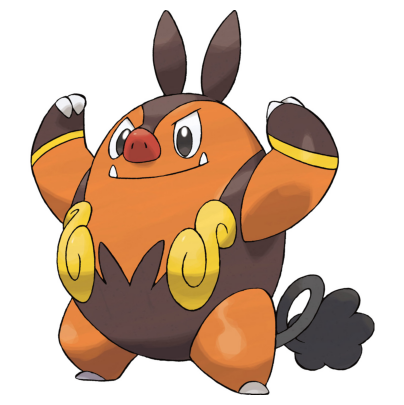

1. The creature is orange.
2. The creature looks very friendly. It has a big smile and its arms are raised in a welcoming gesture.

---

 84%|████████▎ | 167/200 [46:57<02:56,  5.34s/it]

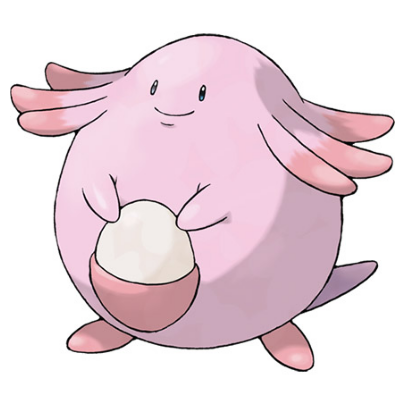

1. The creature is pink.
2. The creature looks friendly. It has a smiling face and is holding an egg, which is often associated with nurturing and care.

---

 84%|████████▍ | 168/200 [47:02<02:50,  5.32s/it]

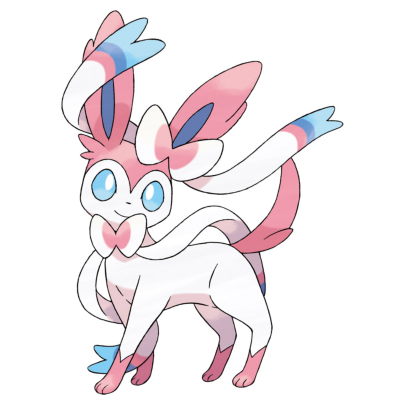

1. The creature is pink and white.
2. The creature looks friendly. It has a big smile and its ears are perked up, which often indicates that an animal is happy or alert.

---

 84%|████████▍ | 169/200 [47:08<02:50,  5.50s/it]

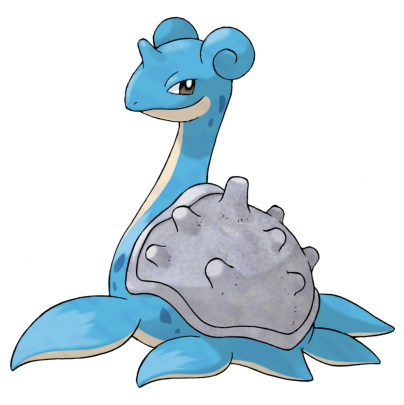

1. The creature is blue.
2. The creature looks friendly. It has a smiling expression and its body language is relaxed, with its fins spread out.

---

 85%|████████▌ | 170/200 [47:13<02:39,  5.33s/it]

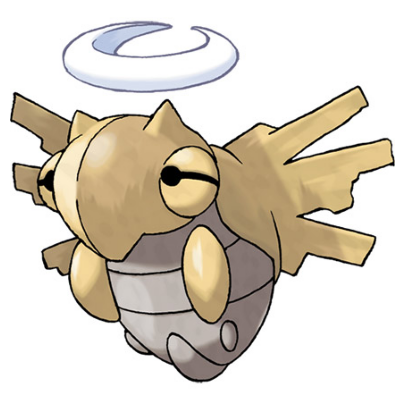

1. The creature is primarily brown with some yellow and white accents.
2. The creature has a friendly expression with its big eyes and the way it's smiling.

---

 86%|████████▌ | 171/200 [47:18<02:31,  5.22s/it]

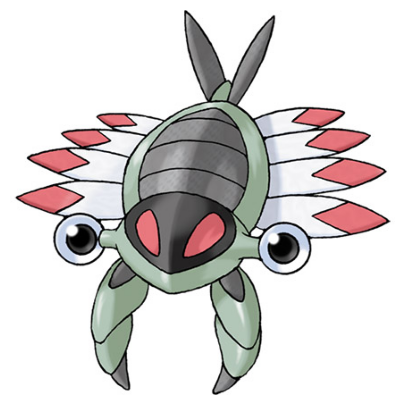

1. The creature is primarily green with red accents.
2. The creature has a somewhat unfriendly appearance due to its sharp, pointed features and the large, red eyes that give it a predatory look.

---

 86%|████████▌ | 172/200 [47:25<02:35,  5.55s/it]

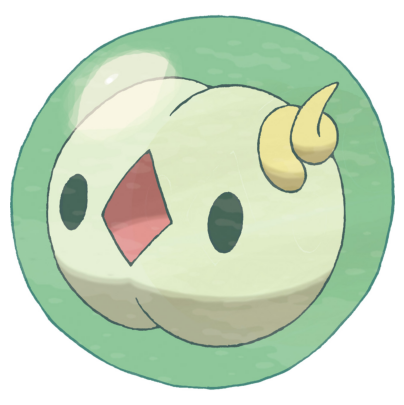

1. The creature is white.
2. The creature looks friendly. It has a smiling face and a cheerful expression, which often indicates a friendly demeanor.

---

 86%|████████▋ | 173/200 [47:30<02:26,  5.44s/it]

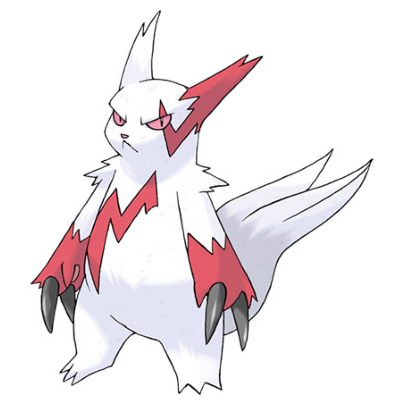

1. The creature is white with red and black accents.
2. The creature looks unfriendly due to its intense stare and the sharpness of its claws.

---

 87%|████████▋ | 174/200 [47:35<02:21,  5.43s/it]

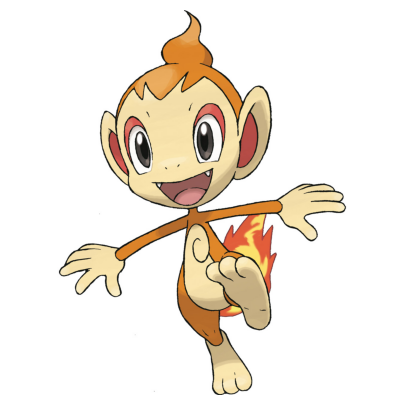

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its arms are outstretched, which can be seen as a welcoming gesture.

---

 88%|████████▊ | 175/200 [47:41<02:16,  5.48s/it]

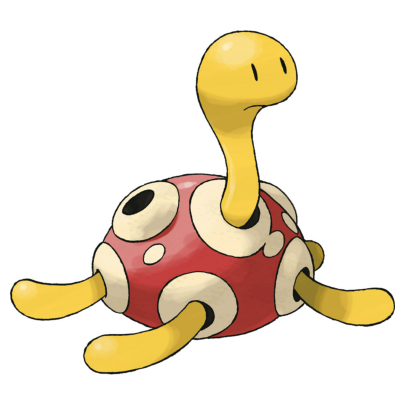

1. The creature is primarily red and white.
2. The creature has a neutral expression, with a slight frown, which suggests it might be indifferent or contemplative.

---

 88%|████████▊ | 176/200 [47:46<02:12,  5.52s/it]

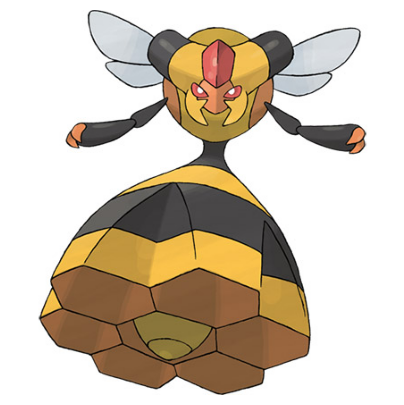

1. The creature is primarily yellow with black and red accents.
2. The creature looks unfriendly due to its aggressive stance, with its arms outstretched and its mouth open in a snarling expression.

---

 88%|████████▊ | 177/200 [47:54<02:18,  6.03s/it]

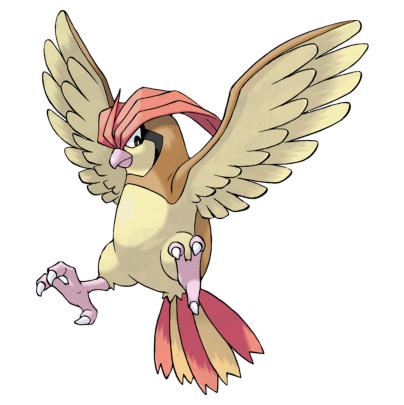

1. The creature is primarily yellow with red and pink accents.
2. The creature looks unfriendly due to its sharp beak and intense gaze.

---

 89%|████████▉ | 178/200 [47:59<02:07,  5.80s/it]

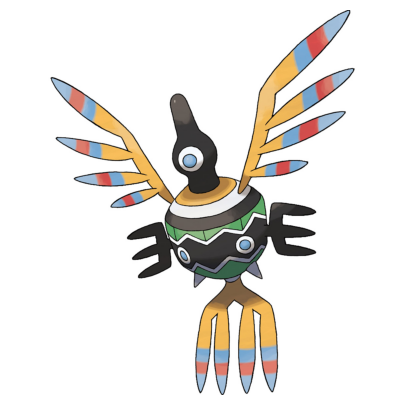

1. The creature is primarily black with yellow, blue, and red accents.
2. The creature has a somewhat unfriendly appearance due to its sharp beak and claws, which could be perceived as threatening.

---

 90%|████████▉ | 179/200 [48:06<02:07,  6.07s/it]

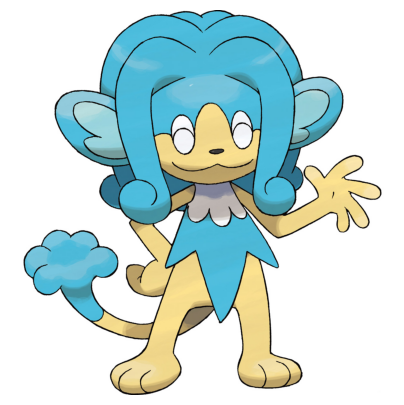

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its arms are outstretched in a welcoming gesture.

---

 90%|█████████ | 180/200 [48:11<01:54,  5.74s/it]

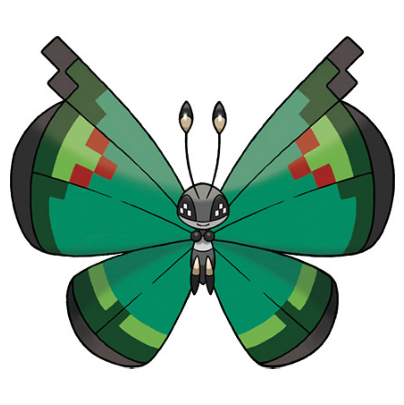

1. The creature is green with red and black accents.
2. The creature looks friendly, with a big smile and a welcoming expression.

---

 90%|█████████ | 181/200 [48:15<01:42,  5.39s/it]

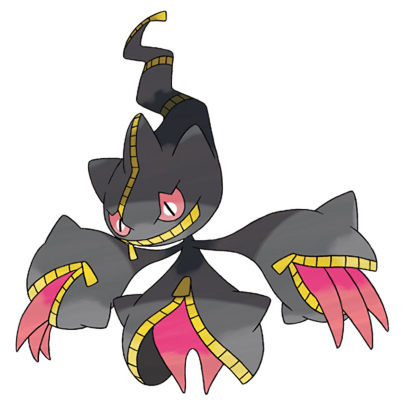

1. The creature is primarily black with some red and yellow accents.
2. The creature has a somewhat unfriendly appearance due to its sharp teeth and the intense look in its eyes.

---

 91%|█████████ | 182/200 [48:21<01:38,  5.50s/it]

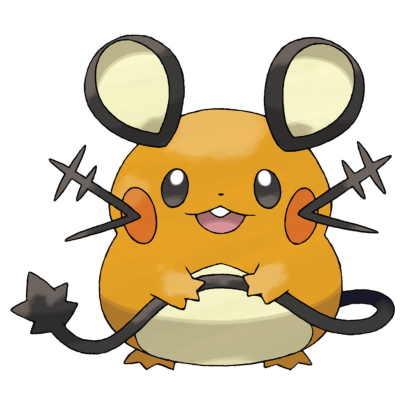

1. The creature is orange.
2. The creature looks friendly. It has a big smile and its ears are perked up, which are signs of happiness and friendliness in many animals.

---

 92%|█████████▏| 183/200 [48:27<01:35,  5.61s/it]

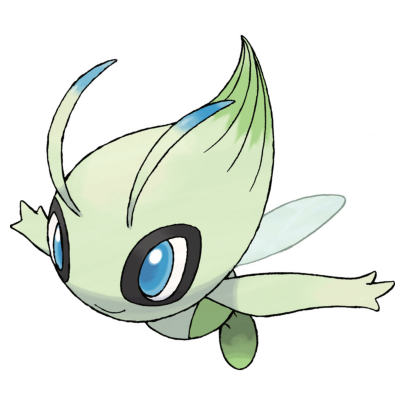

1. The creature is primarily green with blue eyes and a blue stripe on its head.
2. The creature has a friendly appearance, with a wide smile and a relaxed posture. Its large eyes and expressive facial features suggest that it is approachable and may be perceived as cute or endearing.

---

 92%|█████████▏| 184/200 [48:36<01:45,  6.59s/it]

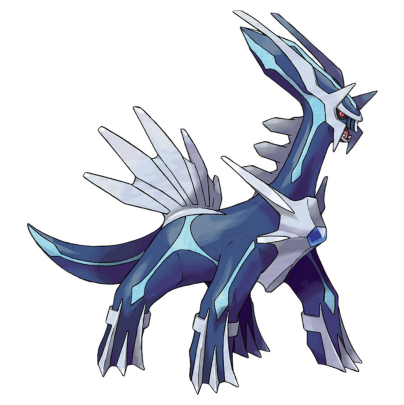

1. The creature is blue and white.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture of its wings.

---

 92%|█████████▎| 185/200 [48:41<01:31,  6.12s/it]

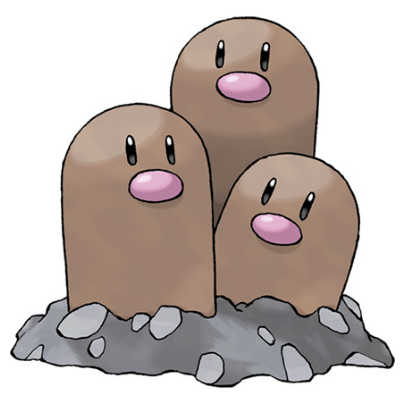

1. The creature is brown.
2. The creature looks friendly, as it has a smiling expression and is depicted in a playful, cartoonish manner.

---

 93%|█████████▎| 186/200 [48:46<01:22,  5.86s/it]

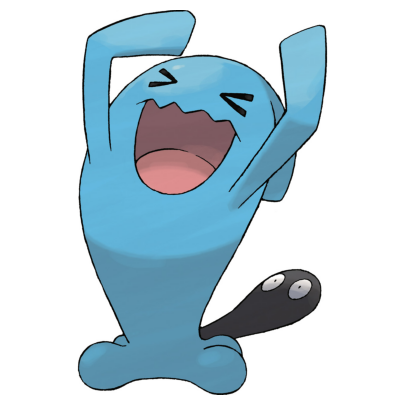

1. The creature is blue.
2. The creature looks friendly. It has a big smile and its arms are raised in a welcoming gesture.

---

 94%|█████████▎| 187/200 [48:51<01:12,  5.55s/it]

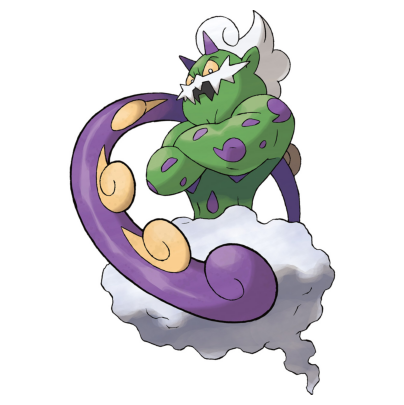

1. The creature is green with purple spots.
2. The creature looks unfriendly due to its open mouth and the menacing expression on its face.

---

 94%|█████████▍| 188/200 [48:56<01:05,  5.46s/it]

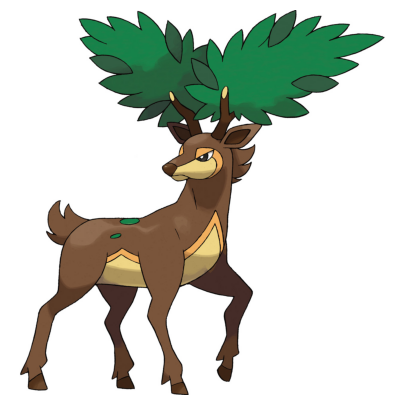

1. The creature is brown and green.
2. The creature looks friendly. It has a gentle expression and is holding a tree above its head, which could be seen as a playful or protective gesture.

---

 94%|█████████▍| 189/200 [49:02<01:03,  5.76s/it]

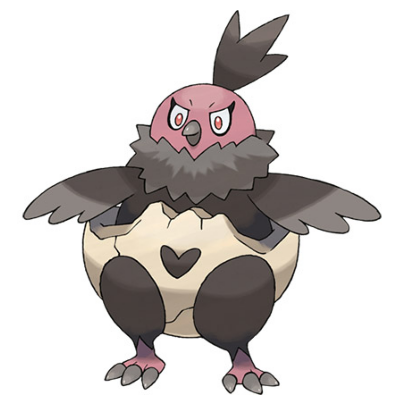

1. The creature is primarily black and white with some pink accents.
2. The creature looks unfriendly due to its intense stare and the way its feathers are puffed out, giving it a menacing appearance.

---

 95%|█████████▌| 190/200 [49:10<01:01,  6.18s/it]

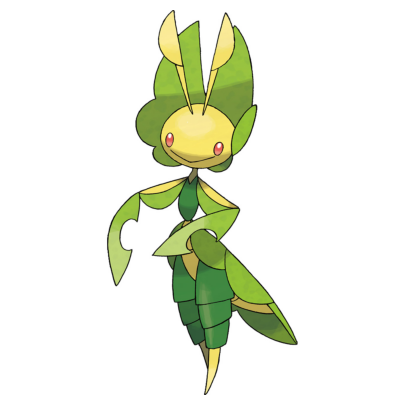

1. The creature is green.
2. The creature looks friendly. It has a big smile and its body language suggests it is relaxed and comfortable.

---

 96%|█████████▌| 191/200 [49:14<00:52,  5.80s/it]

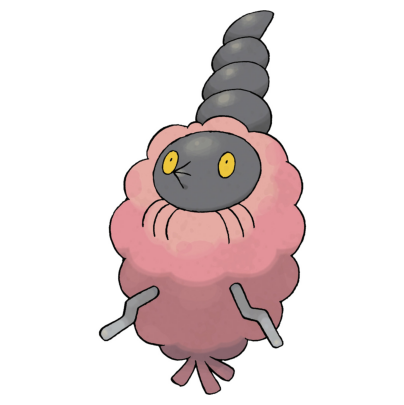

1. The creature is pink and grey.
2. The creature looks unfriendly due to its large, sharp teeth and the intense stare it is giving.

---

 96%|█████████▌| 192/200 [49:20<00:45,  5.67s/it]

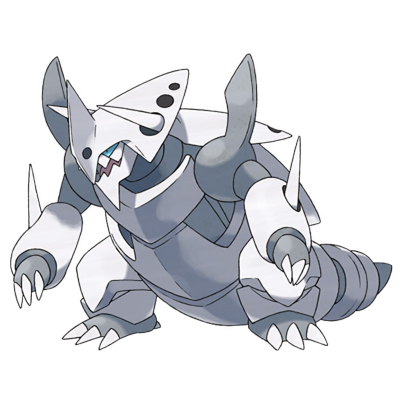

1. The creature is primarily white with some gray and black accents.
2. The creature looks unfriendly due to its sharp teeth and the aggressive posture it is in, with its mouth open and claws extended.

---

 96%|█████████▋| 193/200 [49:27<00:42,  6.09s/it]

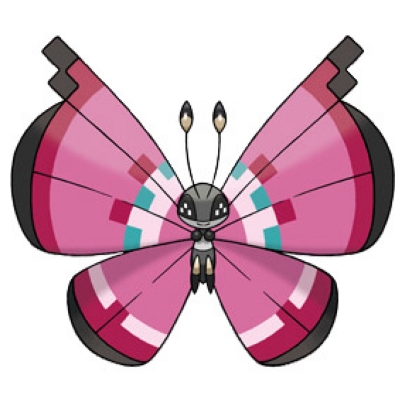

1. The creature is pink with blue and aqua accents.
2. The creature looks friendly, with a big smile and a cheerful expression.

---

 97%|█████████▋| 194/200 [49:32<00:34,  5.79s/it]

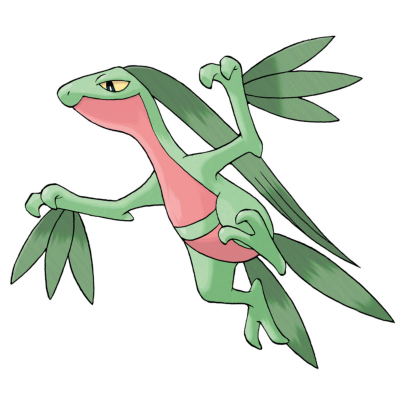

1. The creature is green with pink accents.
2. The creature looks friendly, as it has a wide smile and its wings are spread out in a welcoming manner.

---

 98%|█████████▊| 195/200 [49:38<00:29,  5.80s/it]

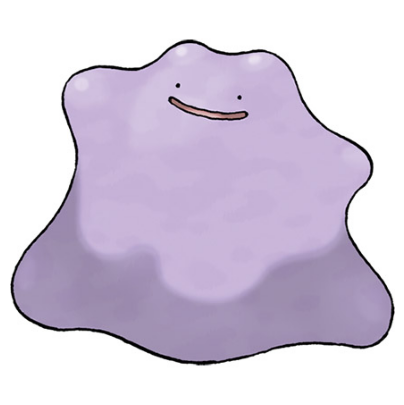

1. The creature is purple.
2. The creature looks friendly. It has a big smile and a relaxed posture, which often indicates a sense of contentment and approachability.

---

 98%|█████████▊| 196/200 [49:44<00:23,  5.87s/it]

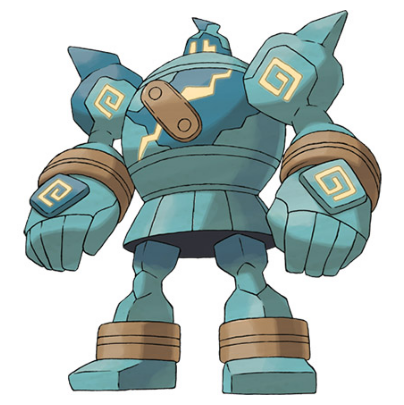

1. The creature is blue.
2. The creature looks very unfriendly. It has a stern expression and is depicted with a weapon, suggesting it is a warrior or a fighter.

---

 98%|█████████▊| 197/200 [49:50<00:17,  5.97s/it]

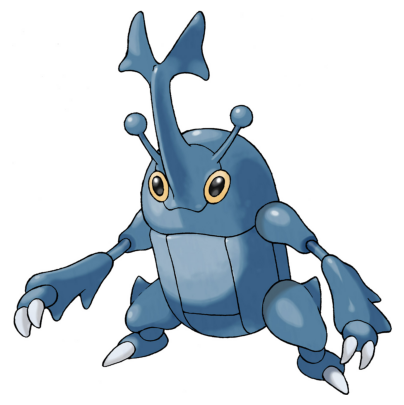

1. The creature is blue.
2. The creature looks friendly. It has a big smile and big eyes, which often indicate a friendly or approachable demeanor in cartoons or illustrations.

---

 99%|█████████▉| 198/200 [49:57<00:12,  6.11s/it]

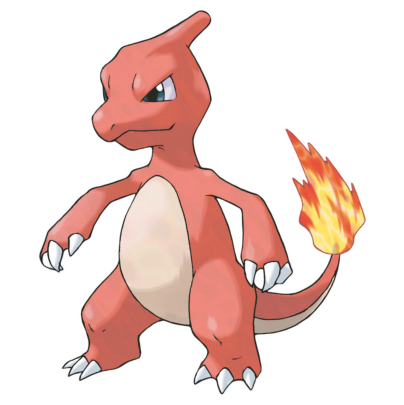

1. The creature is red.
2. The creature looks unfriendly due to its frowning facial expression and the presence of flames coming from its tail, which is often associated with aggression or danger.

---

100%|█████████▉| 199/200 [50:03<00:06,  6.24s/it]

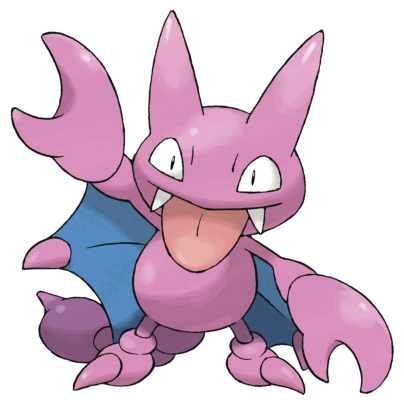

1. The creature is pink.
2. The creature looks unfriendly due to its sharp teeth and the intense expression on its face.

---

100%|██████████| 200/200 [50:08<00:00, 15.04s/it]


In [3]:
prompt = '''
Answer the following questions and reply by filling in the format below.
Accuracy matters and it is essential that fi you are unsure about any answer to a question simply say "I am not sure".

1. What color is the creature?: YOUR ANSWER
2. How friendly or unfriendly does the creature look and why do you think that?: YOUR ANSWER
'''
results = []
progressor = list(range(0, 800))
random.shuffle(progressor)
n_predictions = 200
for i in tqdm(progressor[:n_predictions]):
    image = image_ds['train'][i]['image']
    result = model_pipeline(
        image_ds['train'][i]['image'],
        prompt=base_prompt(prompt),
        generate_kwargs={
            'max_new_tokens': 512,
            'temperature': 0.2,
        }
    )
    results.append([
        i,
        result[0]['generated_text'].split('ASSISTANT: ')[-1]
    ])

    # Display results
    plot_image(image)
    display(Markdown(results[-1][1]))
    display(Markdown('---'))
results = pd.DataFrame(results, columns=['index', 'response'])
results.to_csv('data/pokemon-text-descriptions.csv', index=False)